In [1]:
!pip install matplotlib

In [2]:
!pip install opencv-python

In [3]:
!pip install scipy

In [5]:
!pip install -q kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 /root/.kaggle/kaggle.json
!kaggle datasets download -d tthien/shanghaitech

mkdir: cannot create directory ‘/root/.kaggle’: File exists
100%|████████████████████████████████████████| 333M/333M [00:07<00:00, 81.9MB/s]
100%|████████████████████████████████████████| 333M/333M [00:07<00:00, 48.8MB/s]


In [6]:
!unzip "/notebooks/shanghaitech.zip" -d "/notebooks/shanghaitech/"

Archive:  /notebooks/shanghaitech.zip
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_1.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_10.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_100.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_101.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_102.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_103.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_104.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_105.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_106.mat  
  inflating: /notebooks/shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/GT_IMG_107.m

# Imports

In [1]:
import tensorflow as tf### models
import numpy as np### math computations
import matplotlib.pyplot as plt### plotting bar chart
import cv2## image processing
import scipy.io
import os
import copy
from tensorflow.keras import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import (Activation, MaxPooling2D, Conv2D, MaxPool2D, Dense,
                                     Flatten, BatchNormalization, Input, Concatenate,
                                     Dropout, RandomFlip, RandomRotation,RandomZoom,RandomBrightness,
                                    Rescaling, Resizing, Reshape,LeakyReLU, ReLU, Conv2DTranspose)
from tensorflow.keras.optimizers import Adam,RMSprop
from tensorflow.keras.callbacks import (Callback, CSVLogger, EarlyStopping, LearningRateScheduler,
                                        ModelCheckpoint, ReduceLROnPlateau)
from tensorflow.keras.initializers import RandomNormal
from pathlib import Path
from scipy.ndimage import gaussian_filter

In [2]:
IN_Y,IN_X=512,512
OUT_Y,OUT_X=64,64
SUBSAMPLING_FACTOR=IN_X//OUT_X
INPUT_DIM = 180

# Gauss Distribution

In [3]:
def gauss_distribution(x,u=0,sigma=6):
    return np.expand_dims(1/(np.sqrt(2*np.pi*(sigma**2)))*np.exp(-(0.5)*(((x-u)/sigma)**2)),axis=0)

In [4]:
def get_density_map(pts,OUT_Y=OUT_Y,OUT_X=OUT_X,sigma=6,gaussian_radius=10):
    density_map = np.zeros(shape=(OUT_Y,OUT_X))
    h, w = OUT_Y,OUT_X
    num_gt = len(pts)
    for p in pts:
        p = np.round(p).astype(int)
        p[0],p[1] = min(h-1,p[1]),min(w-1,p[0])
        x = np.linspace(-gaussian_radius,gaussian_radius,(2*gaussian_radius)+1)
        x_dist = gauss_distribution(x,sigma=sigma)
        gaussian_map = x_dist.T @ x_dist
        gaussian_map /= np.sum(gaussian_map)
        
        x_left,y_up,x_right,y_down = 0,0,gaussian_map.shape[1],gaussian_map.shape[0]
        if p[0]<gaussian_radius:
            y_up = gaussian_radius-p[0]
        if p[1]<gaussian_radius:
            x_left = gaussian_radius-p[1]
        if p[0]>=(h-gaussian_radius):
            y_down = gaussian_map.shape[0]-(p[0]+gaussian_radius-h)-1
        if p[1]>=(w-gaussian_radius):
            x_right = gaussian_map.shape[1]-(p[1]+gaussian_radius-w)-1
        # try:
        density_map[
            max(0,p[0]-gaussian_radius):min(density_map.shape[0],p[0]+gaussian_radius+1),
            max(0,p[1]-gaussian_radius):min(density_map.shape[1],p[1]+gaussian_radius+1)
        ] += gaussian_map[y_up:y_down, x_left:x_right]
    density_map = (density_map*len(pts))/(np.sum(density_map))
        # except:
        #     print(x_dist)
        #     print(gaussian_map.shape)
        #     print(x_left,y_up,x_right,y_down)
        #     print(p)
    return density_map


In [5]:
def gaussian_from_scipy(pts,OUT_Y=OUT_Y,OUT_X=OUT_X,sigma=6,truncate=5*5):
    zeros_mat = np.zeros(shape=(OUT_Y,OUT_X))
    for x, y in pts:
        x = int(x)
        y = int(y)
        zeros_mat[y, x] = 1
    return gaussian_filter(zeros_mat,sigma=sigma,truncate=truncate)

In [6]:
test_image_path = './shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_1.jpg'
test_image_label_path = './shanghaitech/ShanghaiTech/part_A/train_data/ground-truth/GT_IMG_1.mat'
plt.figure(figsize=(20,20))
# preprocess image
test_image = cv2.imread(test_image_path)
test_image = cv2.cvtColor(test_image,cv2.COLOR_BGR2RGB)
# test_image = cv2.resize(test_image,(IN_Y,IN_X))
test_image = test_image.astype('float32')
test_image/=255.
test_image[:,:,0] = (test_image[:,:,0]-np.mean(test_image[:,:,0]))/np.std(test_image[:,:,0])
test_image[:,:,1] = (test_image[:,:,1]-np.mean(test_image[:,:,1]))/np.std(test_image[:,:,1])
test_image[:,:,2] = (test_image[:,:,2]-np.mean(test_image[:,:,2]))/np.std(test_image[:,:,2])
# plt.imshow(test_image)
# plt.show()

# preprocess matrix of points
test_image_label = scipy.io.loadmat(test_image_label_path)
print(test_image_label)
points=test_image_label['image_info'][0][0][0][0][0]
print(points)

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Fri Nov 18 20:06:05 2016', '__version__': '1.0', '__globals__': [], 'image_info': array([[array([[(array([[ 29.6225116 , 472.92022152],
                       [ 54.35533603, 454.96602305],
                       [ 51.79045053, 460.46220626],
                       ...,
                       [597.89732076, 688.27900015],
                       [965.77518336, 638.44693908],
                       [166.9965574 , 628.1873971 ]]), array([[1546]], dtype=uint16))]],
              dtype=[('location', 'O'), ('number', 'O')])                               ]],
      dtype=object)}
[[ 29.6225116  472.92022152]
 [ 54.35533603 454.96602305]
 [ 51.79045053 460.46220626]
 ...
 [597.89732076 688.27900015]
 [965.77518336 638.44693908]
 [166.9965574  628.1873971 ]]


<Figure size 2000x2000 with 0 Axes>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


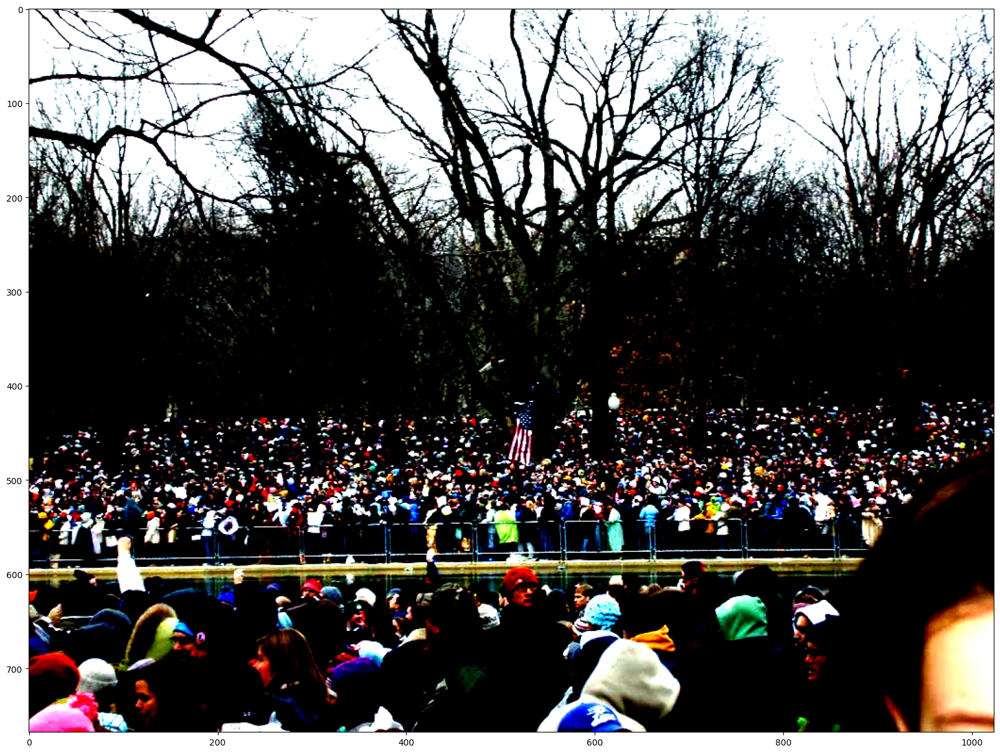

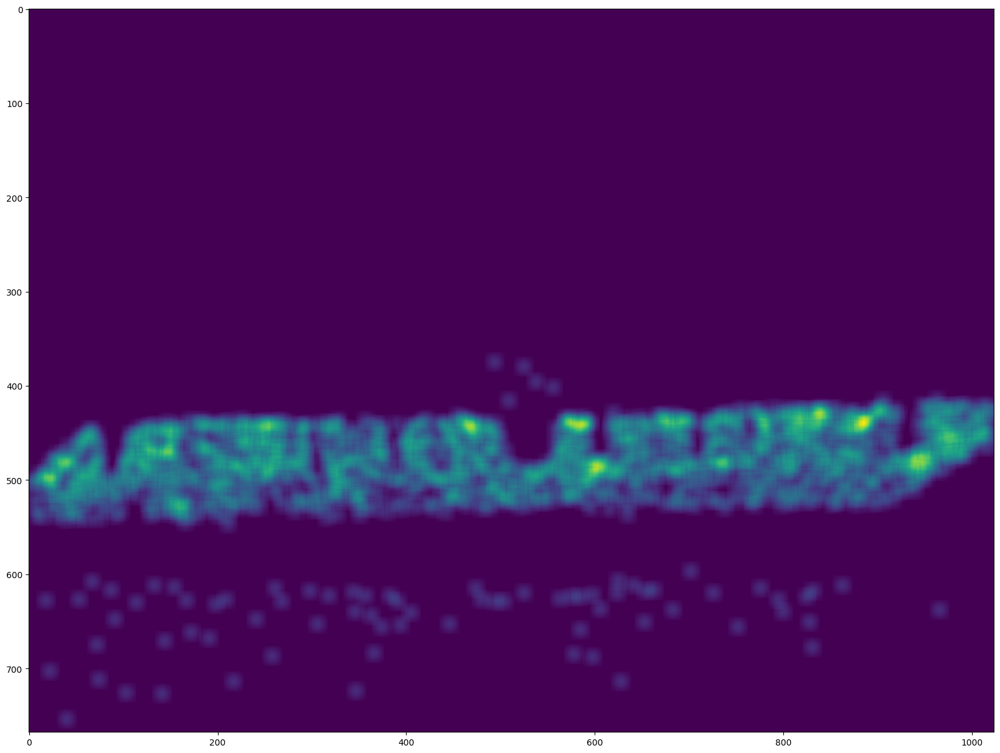

people in image = 1546.0
points = 1546


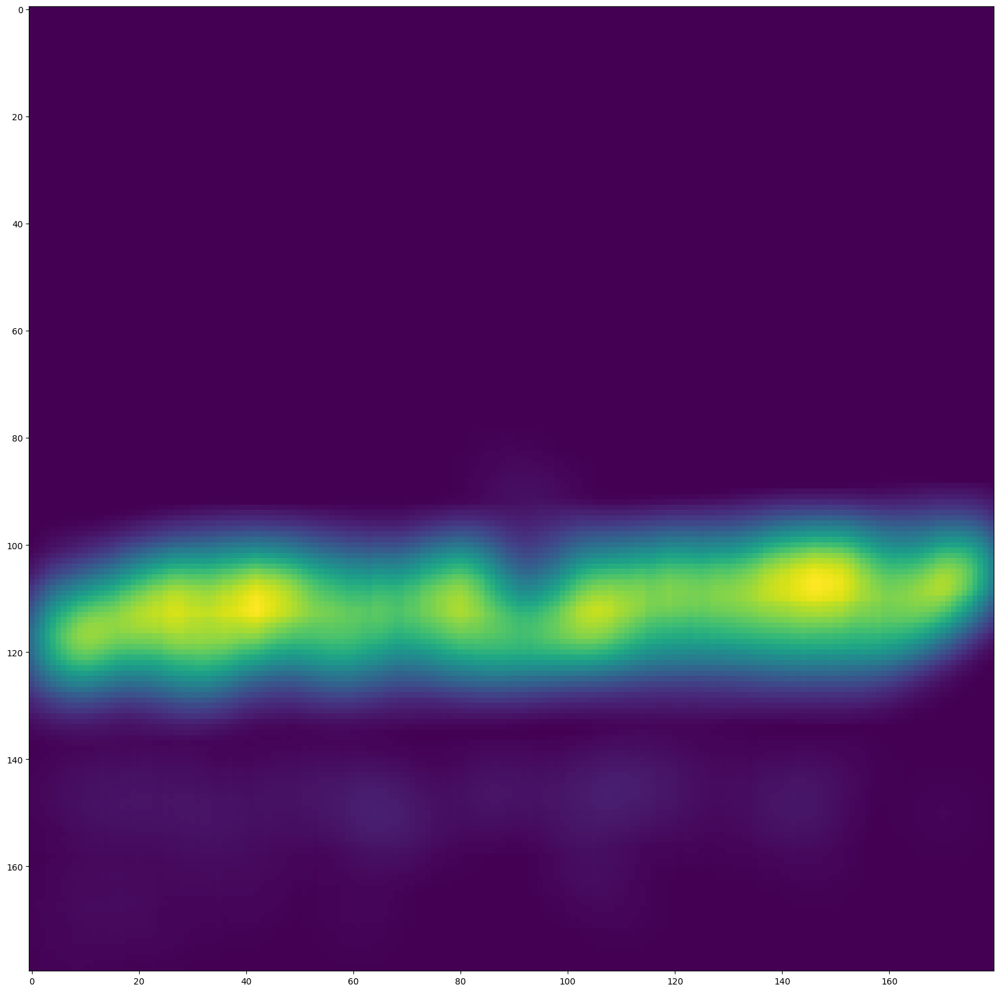

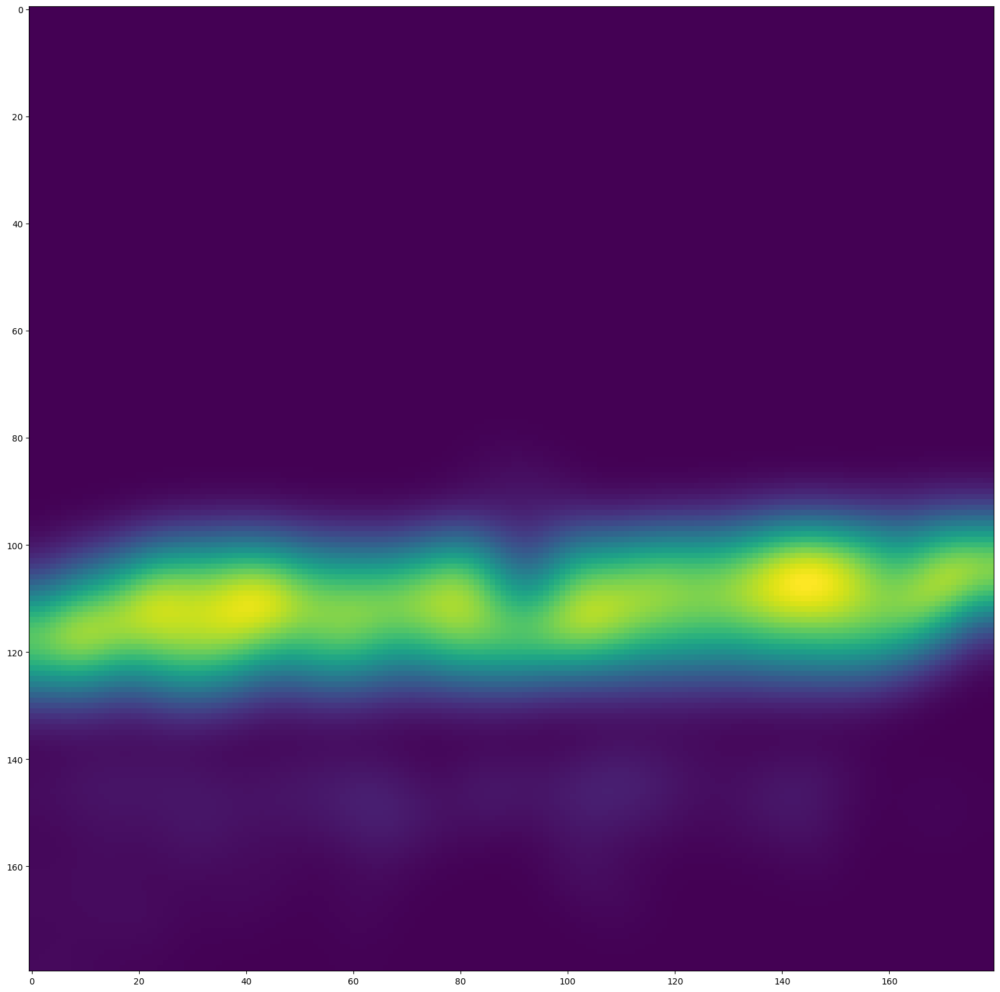

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


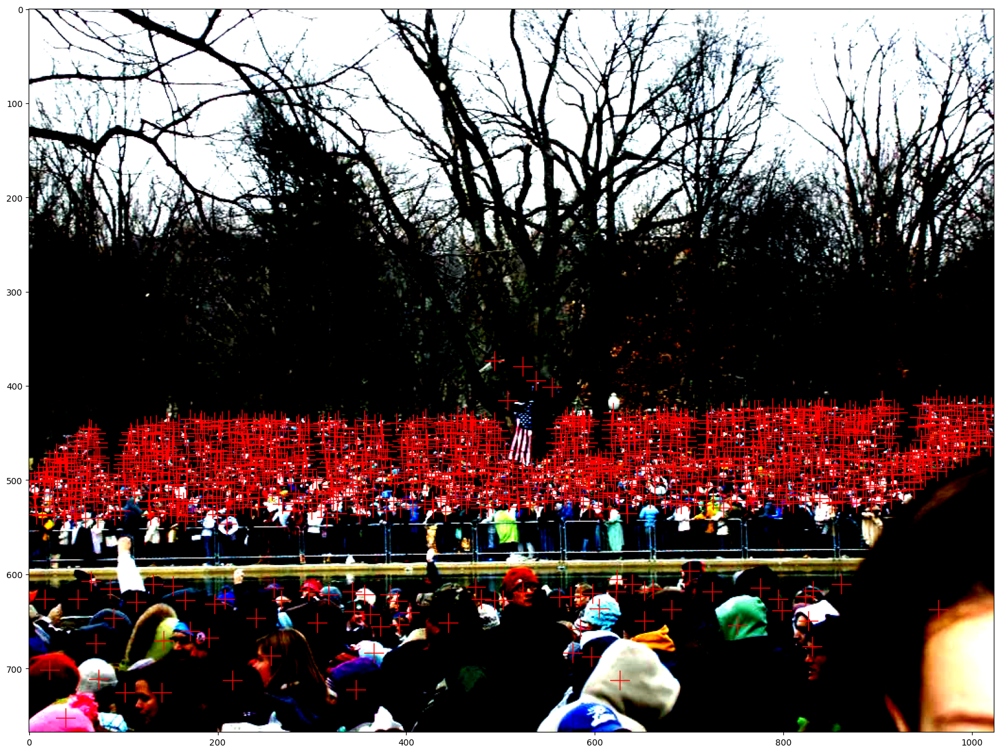

In [7]:
plt.figure(figsize=(20,20))
plt.imshow(test_image)
plt.show()


# points/=SUBSAMPLING_FACTOR
label_map_1 = get_density_map(points,OUT_Y=test_image.shape[0],OUT_X=test_image.shape[1],gaussian_radius=10)
plt.figure(figsize=(20,20))
plt.imshow(label_map_1)
plt.show()

im_shape=test_image.shape
points_copy = copy.deepcopy(points)
points[:,0]*=(INPUT_DIM/im_shape[1])
points[:,1]*=(INPUT_DIM/im_shape[0])
label_map_2 = gaussian_from_scipy(points,OUT_Y=test_image.shape[0],OUT_X=test_image.shape[1])
label_map_2 = get_density_map(points,OUT_Y=INPUT_DIM,OUT_X=INPUT_DIM,gaussian_radius=10)
print("people in image = "+str(np.sum(label_map_2)))
print("points = "+str(len(points)))
# label_map_2=cv2.resize(label_map_2,(OUT_Y,OUT_X))
plt.figure(figsize=(20,20))
plt.imshow(label_map_2)
plt.show()

label_map_3 = gaussian_from_scipy(points,OUT_Y=INPUT_DIM,OUT_X=INPUT_DIM)
plt.figure(figsize=(20,20))
plt.imshow(label_map_3)
plt.show()

for x, y in points_copy:
    x = int(x)
    y = int(y)
    cv2.drawMarker(test_image, (x,y), (255, 0, 0),thickness=1) 
plt.figure(figsize=(20,20))
plt.imshow(test_image)
plt.show()

# Using Data Generators

In [464]:
class DataGenerator(tf.keras.utils.Sequence):
    def __init__ (self, images, maps, batch_size,INPUT_DIM=INPUT_DIM):
        self.images = images
        self.maps = maps
        self.batch_size = batch_size
        self.train_image_list=os.listdir(images)
        self.INPUT_DIM = INPUT_DIM
    def __len__(self):
        return int(np.floor(len(self.train_image_list)/self.batch_size))
  
    def __getitem__(self, idx):
        x,y = self.__data_generation(idx)
        return x,y
  
    def __data_generation(self, idx):
        x = []
        y = []

        for j in range(idx*self.batch_size, (idx+1)*self.batch_size):
            im_name = os.listdir(self.images)[j]
            im_array=img_to_array(load_img(self.images+os.listdir(self.images)[j],target_size=(IN_Y,IN_X)))
            im_array/=255.
            im_array[:,:,0]=(im_array[:,:,0]-np.mean(im_array[:,:,0]))/np.std(im_array[:,:,0])
            im_array[:,:,1]=(im_array[:,:,1]-np.mean(im_array[:,:,1]))/np.std(im_array[:,:,1])
            im_array[:,:,2]=(im_array[:,:,2]-np.mean(im_array[:,:,2]))/np.std(im_array[:,:,2])
            x.append(im_array)
            im_shape = im_array.shape
            mat=scipy.io.loadmat(self.maps+'GT_'+im_name[:-3]+'mat')
            points=mat['image_info'][0][0][0][0][0]
            points[:,0]*=(self.INPUT_DIM/im_shape[1])
            points[:,1]*=(self.INPUT_DIM/im_shape[0])
            
            density_map_present=get_density_map(points,gaussian_radius=5)
            y.append(density_map_present)
            
        return tf.convert_to_tensor(x),tf.convert_to_tensor(y)
     

In [19]:
train_images='./shanghaitech/ShanghaiTech/part_A/train_data/images/'
train_maps='./shanghaitech/ShanghaiTech/part_A/train_data/ground-truth/'
val_images='./shanghaitech/ShanghaiTech/part_A/test_data/images/'
val_maps='./shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/'

LR=1e-5
BATCH_SIZE=16
EPOCH=1000

In [11]:
for x in os.listdir(train_images)[:10]:
    print(x)

IMG_1.jpg
IMG_10.jpg
IMG_100.jpg
IMG_101.jpg
IMG_102.jpg
IMG_103.jpg
IMG_104.jpg
IMG_105.jpg
IMG_106.jpg
IMG_107.jpg


In [12]:
for x in os.listdir(train_maps)[:10]:
    print(x)

GT_IMG_1.mat
GT_IMG_10.mat
GT_IMG_100.mat
GT_IMG_101.mat
GT_IMG_102.mat
GT_IMG_103.mat
GT_IMG_104.mat
GT_IMG_105.mat
GT_IMG_106.mat
GT_IMG_107.mat


In [15]:
train_gen = DataGenerator(train_images, train_maps, BATCH_SIZE)
val_gen = DataGenerator(val_images, val_maps,BATCH_SIZE)

# CSRNET Model

In [197]:
def get_base_model():
    base_model = VGG16(
        weights='imagenet',
        input_shape=(IN_Y,IN_X,3),
        include_top=False,
    )
    
    block4_conv3=base_model.get_layer('block4_conv3').output 
    
    return Model(
        inputs=[base_model.inputs],outputs=[block4_conv3]
    )

base_model = get_base_model()
base_model.summary()

Model: "model_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_43 (InputLayer)       [(None, 512, 512, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 512, 512, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 512, 512, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 256, 256, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 256, 256, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 256, 256, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 128, 128, 128)     0  

In [198]:
def get_csrnet_model():
    inputs=Input(shape=(IN_Y,IN_X,3))
    base_model = get_base_model()
    x=base_model(inputs)
    init=RandomNormal(0.01)

    x=Conv2D(512, (3,3), activation = 'relu', dilation_rate=2,kernel_initializer=init,padding='same')(x)
    x=Conv2D(512, (3,3), activation = 'relu', dilation_rate=2,kernel_initializer=init,padding='same')(x)
    x=BatchNormalization()(x)
    x=Conv2D(512, (3,3), activation = 'relu', dilation_rate=2,kernel_initializer=init,padding='same')(x)
    x=Conv2D(256, (3,3), activation = 'relu', dilation_rate=2,kernel_initializer=init,padding='same')(x)
    x=BatchNormalization()(x)
    x=Conv2D(128, (3,3), activation = 'relu', dilation_rate=2,kernel_initializer=init,padding='same')(x)
    x=Conv2D(64, (3,3), activation = 'relu', dilation_rate=2,kernel_initializer=init,padding='same')(x)
    x=BatchNormalization()(x)
    x=Conv2D(1, (1,1), activation = 'relu', dilation_rate=1,kernel_initializer=init,padding='same')(x)
    

    out=Reshape((OUT_Y,OUT_X))(x)
    csrnet_model=Model(inputs=inputs,outputs=out)
    return csrnet_model

In [92]:
csrnet_model = get_csrnet_model()
csrnet_model.summary()

Model: "model_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_15 (InputLayer)       [(None, 512, 512, 3)]     0         
                                                                 
 model_14 (Functional)       (None, 64, 64, 512)       7635264   
                                                                 
 conv2d_56 (Conv2D)          (None, 64, 64, 512)       2359808   
                                                                 
 conv2d_57 (Conv2D)          (None, 64, 64, 512)       2359808   
                                                                 
 batch_normalization_21 (Bat  (None, 64, 64, 512)      2048      
 chNormalization)                                                
                                                                 
 conv2d_58 (Conv2D)          (None, 64, 64, 512)       2359808   
                                                          

In [56]:
def custom_loss(y_true,y_pred):
    return tf.sqrt(tf.math.reduce_sum(tf.square(y_true-y_pred)))

In [10]:
csrnet_model.compile(
    loss = custom_loss,
    optimizer = Adam(learning_rate = 1e-4),
    metrics='accuracy',
    # run_eagerly = True,
)

In [75]:
checkpoint_filepath='./counting_people_model_csrnet_without_aug.h5'
callback = ModelCheckpoint(
    filepath = checkpoint_filepath,
    save_weights_only=True,
    monitor='loss',
    mode='min',
    save_best_only=True
)

In [76]:
history = csrnet_model.fit(
    train_gen,
    verbose=1,
    shuffle=True,
    epochs=EPOCH,
    callbacks=[callback]
)

Epoch 1/1000
18/18 [==============================] - 145s 6s/step - loss: 33589544960.0000 - accuracy: 0.0029
Epoch 2/1000
18/18 [==============================] - 105s 5s/step - loss: 4759732736.0000 - accuracy: 0.0055
Epoch 3/1000
18/18 [==============================] - 107s 6s/step - loss: 1275832704.0000 - accuracy: 0.0060
Epoch 4/1000
18/18 [==============================] - 108s 6s/step - loss: 583603008.0000 - accuracy: 0.0048
Epoch 5/1000
18/18 [==============================] - 98s 5s/step - loss: 364557568.0000 - accuracy: 0.0046
Epoch 6/1000
18/18 [==============================] - 115s 6s/step - loss: 259939008.0000 - accuracy: 0.0056
Epoch 7/1000
18/18 [==============================] - 110s 6s/step - loss: 191203296.0000 - accuracy: 0.0068
Epoch 8/1000
18/18 [==============================] - 96s 5s/step - loss: 141475120.0000 - accuracy: 0.0077
Epoch 9/1000
18/18 [==============================] - 102s 5s/step - loss: 103927656.0000 - accuracy: 0.0099
Epoch 10/1000
18/

KeyboardInterrupt: 

# Data preparation 2.0
Preparing images in another way to be faster in training

In [12]:
train_images_A='./shanghaitech/ShanghaiTech/part_A/train_data/images/'
train_maps_A='./shanghaitech/ShanghaiTech/part_A/train_data/ground-truth/'
train_images_B='./shanghaitech/ShanghaiTech/part_B/train_data/images/'
train_maps_B='./shanghaitech/ShanghaiTech/part_B/train_data/ground-truth/'
val_images_A='./shanghaitech/ShanghaiTech/part_A/test_data/images/'
val_maps_A='./shanghaitech/ShanghaiTech/part_A/test_data/ground-truth/'

In [13]:
train_images_A_path = Path(train_images_A)
train_maps_A_path = Path(train_maps_A)
train_images_B_path = Path(train_images_B)
train_maps_B_path = Path(train_maps_B)
val_images_A_path = Path(val_images_A)
val_maps_A_path = Path(val_maps_A)
images_list_A = sorted(list(train_images_A_path.glob(r"*.jpg")))
images_list_B = sorted(list(train_images_B_path.glob(r"*.jpg")))
gt_list_A = sorted(list(train_maps_A_path.glob(r"*.mat")))
gt_list_B = sorted(list(train_maps_B_path.glob(r"*.mat")))
val_images_list_A = sorted(list(val_images_A_path.glob(r"*.jpg")))
val_gt_list_A = sorted(list(val_maps_A_path.glob(r"*.mat")))


In [11]:
images_list_A[:10]

[PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_1.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_10.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_100.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_101.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_102.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_103.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_104.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_105.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_106.jpg'),
 PosixPath('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_107.jpg')]

In [12]:
print("LEN A GT: ",len(gt_list_A))
print("---"*5)
print("LEN A IMAGES: ",len(images_list_A))
print("---"*20)
print("LEN B GT: ",len(gt_list_B))
print("---"*5)
print("LEN B IMAGES: ",len(images_list_B))

LEN A GT:  300
---------------
LEN A IMAGES:  300
------------------------------------------------------------
LEN B GT:  400
---------------
LEN B IMAGES:  400


In [13]:
print(gt_list_A[99])
print(images_list_A[99])

shanghaitech/ShanghaiTech/part_A/train_data/ground-truth/GT_IMG_189.mat
shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_189.jpg


In [14]:
X = []
Y = []
for im_A,im_B,gt_A,gt_B in zip(images_list_A,images_list_B,gt_list_A,gt_list_B):
    X.append(str(im_A))
    X.append(str(im_B))
    Y.append(str(gt_A))
    Y.append(str(gt_B))

X = np.array(X)
Y = np.array(Y)
X_train = X
Y_train = Y

X_val = []
Y_val = []
for im_val_A,gt_val_A in zip(val_images_list_A,val_gt_list_A):
    X_val.append(str(im_val_A))
    Y_val.append(str(gt_val_A))
X_val = np.array(X_val)
Y_val = np.array(Y_val)

In [15]:
X_train[100],Y_train[100]

('shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_144.jpg',
 'shanghaitech/ShanghaiTech/part_A/train_data/ground-truth/GT_IMG_144.mat')

## Preprocess Images

In [15]:
def preprocess_images(im):
    im = cv2.cvtColor(cv2.imread(im),cv2.COLOR_BGR2RGB)
    im_shape = im.shape
    im = cv2.resize(im,(INPUT_DIM,INPUT_DIM))
    im = im.astype('float32')
    im /= 255.
    im[:,:,0] = (im[:,:,0]-np.mean(im[:,:,0]))/np.std(im[:,:,0])
    im[:,:,1] = (im[:,:,1]-np.mean(im[:,:,1]))/np.std(im[:,:,1])
    im[:,:,2] = (im[:,:,2]-np.mean(im[:,:,2]))/np.std(im[:,:,2])
    return im,im_shape

## Preprocess Labels

In [16]:
def preprocess_labels(mat,im_shape,from_scipy):
    points_info = scipy.io.loadmat(mat)["image_info"]
    points = points_info[0][0][0][0][0]
    points[:,0]*=(INPUT_DIM/im_shape[1])
    points[:,1]*=(INPUT_DIM/im_shape[0])
    if not from_scipy:
        label_map = get_density_map(points,OUT_Y=INPUT_DIM,OUT_X=INPUT_DIM)
    else:
        label_map = gaussian_from_scipy(pts=points,OUT_Y=INPUT_DIM,OUT_X=INPUT_DIM,sigma=6,truncate=6*6)
    # label_map = cv2.resize(label_map,(INPUT_DIM,INPUT_DIM))
    return label_map

## Preprocess Data

In [17]:
def preprocess_data(img,mat,from_scipy=False):
    im,im_shape = preprocess_images(img)
    label_map = preprocess_labels(mat,im_shape,from_scipy)
    return im, label_map

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


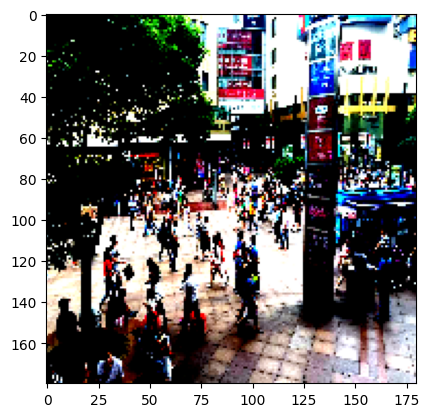

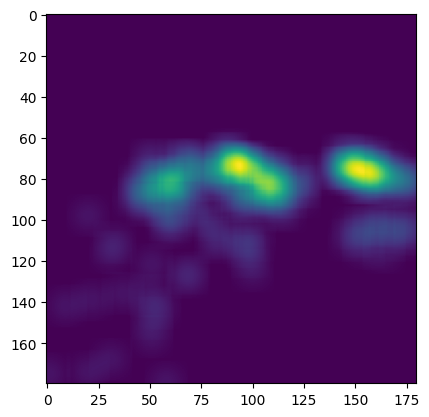

In [19]:
i,l = preprocess_data(X_train[5],Y_train[5])
plt.imshow(i)
plt.show()
plt.imshow(l)
plt.show()

In [123]:
train_ds = [preprocess_data(im,label) for im,label in zip(X_train,Y_train)]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


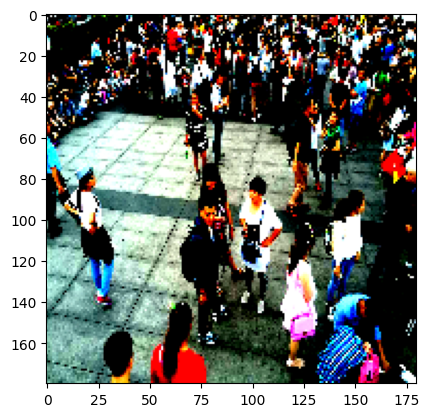

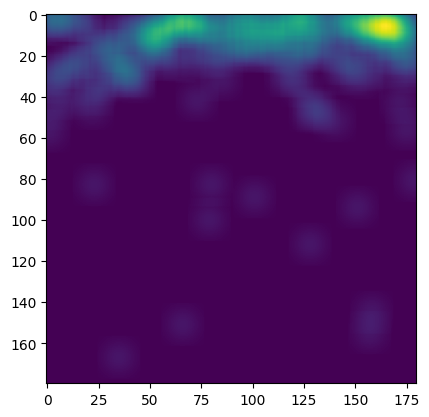

In [124]:
i,l = train_ds[3]
plt.imshow(i)
plt.show()
plt.imshow(l)
plt.show()


In [125]:
images = [item[0] for item in train_ds]
labels = [item[1] for item in train_ds]

In [126]:
images = np.array(images)
labels = np.array(labels)

In [127]:
images.shape

(600, 180, 180, 3)

In [128]:
labels.shape

(600, 180, 180)

In [131]:
train_ds_prep = tf.data.Dataset.from_tensor_slices((images,labels))

In [9]:
class Augment(Layer):
    def __init__(self, seed=42):
        super().__init__()
        # both use the same seed, so they'll make the same random changes.
        # augment input
        self.augment_inputs_flip = RandomFlip(mode="horizontal", seed=seed)
        self.augment_inputs_rotation = RandomRotation(0.2,seed=seed)
        self.augment_inputs_flip_vertical = RandomFlip(mode="vertical", seed=seed)
        self.augment_inputs_brightness = RandomBrightness(factor=0.1, seed=seed)
        # self.augment_inputs_zoom = RandomZoom(0.2,seed=seed)
        # augment labels
        self.augment_labels_flip = RandomFlip(mode="horizontal", seed=seed)
        self.augment_labels_rotation = RandomRotation(0.2,seed=seed)
        self.augment_labels_flip_vertical = RandomFlip(mode="vertical", seed=seed)
        self.augment_labels_brightness = RandomBrightness(factor=0.1, seed=seed)
        # self.augment_labels_zoom = RandomZoom(0.2,seed=seed)

    def call(self, inputs, labels):
        inputs = self.augment_inputs_flip(inputs)
        inputs = self.augment_inputs_rotation(inputs)
        inputs = self.augment_inputs_flip_vertical(inputs)
        inputs = self.augment_inputs_brightness(inputs)
        # inputs = self.augment_inputs_zoom(inputs)

        labels = self.augment_labels_flip(labels)
        labels = self.augment_labels_rotation(labels)
        labels = self.augment_labels_flip_vertical(labels)
        labels = self.augment_labels_brightness(labels)
        # labels = self.augment_labels_zoom(labels)
        return inputs, labels

In [133]:
train_ds

<TensorSliceDataset element_spec=(TensorSpec(shape=(180, 180, 3), dtype=tf.float32, name=None), TensorSpec(shape=(180, 180), dtype=tf.float64, name=None))>

In [134]:
train_ds= train_ds_prep.shuffle(buffer_size=64).batch(BATCH_SIZE).map(Augment()).prefetch(buffer_size=tf.data.AUTOTUNE)

In [135]:
train_ds_no_aug= train_ds_prep.shuffle(buffer_size=64).batch(BATCH_SIZE).prefetch(buffer_size=tf.data.AUTOTUNE)

In [136]:
train_ds

<PrefetchDataset element_spec=(TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 180, 180), dtype=tf.float32, name=None))>

## Prepare ds pipelined

In [16]:
BATCH_SIZE=32

In [10]:
def prepare_ds(x,y,shuffle=False,augment=False,from_scipy=False):
    ds = [preprocess_data(im,label,from_scipy) for im,label in zip(x,y)]
    imgs = np.array([item[0] for item in ds])
    mats = np.array([item[1] for item in ds])
    ds = tf.data.Dataset.from_tensor_slices((imgs,mats))
    if shuffle:
        ds = ds.shuffle(buffer_size=64)
    
    ds = ds.batch(BATCH_SIZE)
    
    if augment:
        ds = ds.map(Augment())
    
    ds = ds.prefetch(buffer_size=tf.data.AUTOTUNE)
    return ds

In [21]:
val_ds = prepare_ds(X_val,Y_val) 

# val_ds = [preprocess_data(im,label) for im,label in zip(X_val,Y_val)]
# val_images = [item[0] for item in val_ds]
# val_labels = [item[1] for item in val_ds]
# val_images = np.array(val_images)
# val_labels = np.array(val_labels)
# val_ds = tf.data.Dataset.from_tensor_slices((val_images,val_labels))

In [22]:
val_ds

<PrefetchDataset element_spec=(TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 180, 180), dtype=tf.float64, name=None))>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


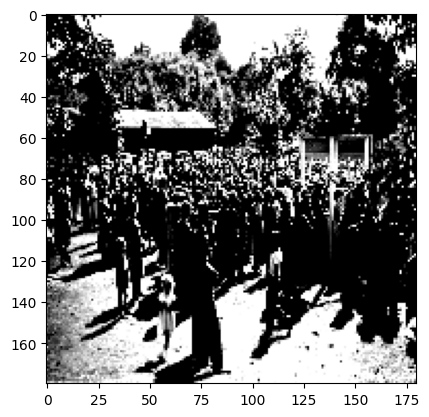

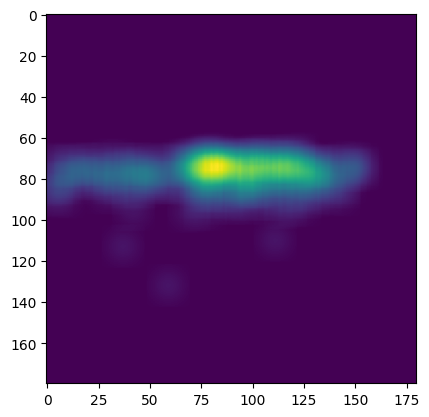

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


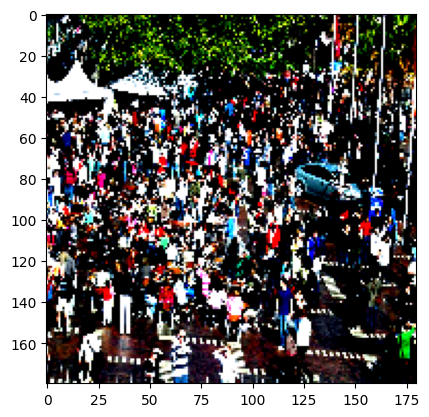

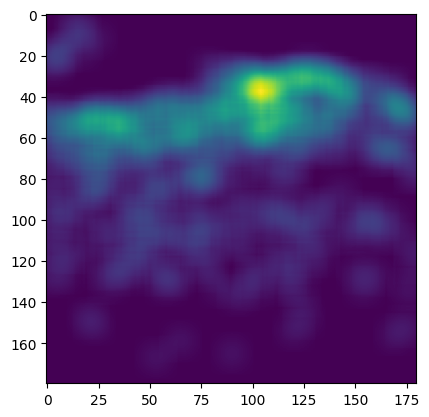

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


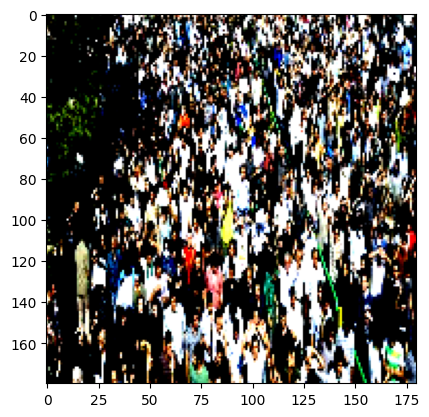

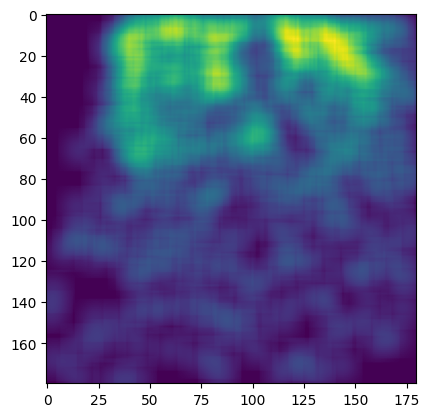

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


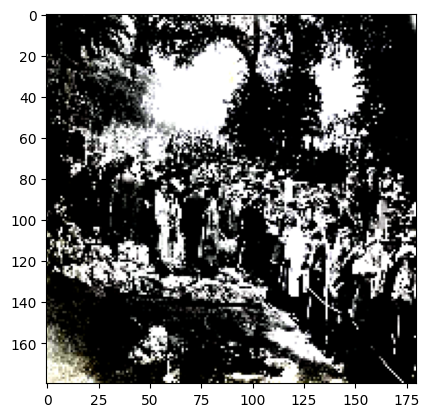

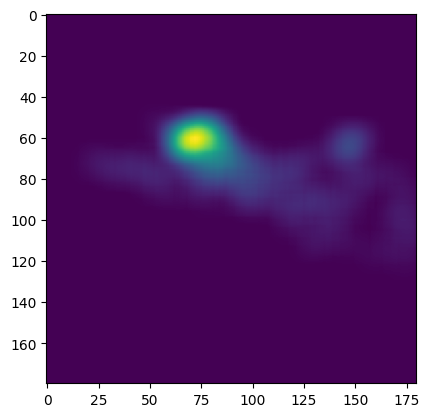

In [22]:
j=0
for i,l in val_ds.take(1).unbatch():
    plt.imshow(i)
    plt.show()
    plt.imshow(l)
    plt.show()
    j+=1
    if j>3:
        break


In [20]:
train_ds_scipy = prepare_ds(X_train,Y_train,shuffle=True,augment=True,from_scipy=True)
val_ds_scipy = prepare_ds(X_val,Y_val,from_scipy=True)

# Encoder/Decoder Architecture

## Callbacks

In [21]:
def create_earlystopping():
    Early_Stopper = EarlyStopping(monitor="val_loss",patience=4,mode="min")
    return Early_Stopper


checkpoint_filepath='./counting_people_model_auto_encoder.h5'
def create_checkpoint_callback(checkpoint_filepath):
    Checkpoint_Model = ModelCheckpoint(
                            monitor="val_loss",
                            save_best_only=True,
                            save_weights_only=True,
                            filepath=checkpoint_filepath
                        )
    return Checkpoint_Model

Checkpoint_Model = create_checkpoint_callback(checkpoint_filepath)
callbacks = [Checkpoint_Model]

def create_reduceLrOnPlateau():
    return ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=3,
        verbose=0,
        mode='auto',
        min_delta=0.0001,
    )

## Encoder

In [22]:
compile_loss = "mse"
compile_optimizer = Adam(learning_rate=1e-5)
output_class = 1

In [23]:
def encoder_ae(INPUT_DIM):
    Encoder_AE = Sequential()
    Encoder_AE.add(Input(shape=(INPUT_DIM,INPUT_DIM,3)))
    Encoder_AE.add(Conv2D(32,(2,2),kernel_initializer = 'he_normal'))
    Encoder_AE.add(BatchNormalization())
    Encoder_AE.add(ReLU())
    #
    Encoder_AE.add(Conv2D(64,(2,2),kernel_initializer = 'he_normal'))
    Encoder_AE.add(BatchNormalization())
    Encoder_AE.add(ReLU())
    #
    Encoder_AE.add(Conv2D(128,(2,2),kernel_initializer = 'he_normal'))
    Encoder_AE.add(BatchNormalization())
    Encoder_AE.add(ReLU())
    #
    Encoder_AE.add(Conv2D(256,(2,2),kernel_initializer = 'he_normal'))
    Encoder_AE.add(BatchNormalization())
    Encoder_AE.add(ReLU())
    return Encoder_AE


In [24]:
Encoder_AE = encoder_ae(INPUT_DIM=180)
Encoder_AE.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 179, 179, 32)      416       
                                                                 
 batch_normalization (BatchN  (None, 179, 179, 32)     128       
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 179, 179, 32)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 178, 178, 64)      8256      
                                                                 
 batch_normalization_1 (Batc  (None, 178, 178, 64)     256       
 hNormalization)                                                 
                                                                 
 re_lu_1 (ReLU)              (None, 178, 178, 64)      0

In [25]:
decoder_input_shape = Encoder_AE.output.shape[1:]

## Decoder

In [26]:
def decoder_ae(decoder_input_shape):
    Decoder_AE = Sequential()
    Decoder_AE.add(Input(shape=decoder_input_shape))
    Decoder_AE.add(Conv2DTranspose(128,(2,2)))
    Decoder_AE.add(ReLU())
    #
    Decoder_AE.add(Conv2DTranspose(64,(2,2)))
    Decoder_AE.add(ReLU())
    #
    Decoder_AE.add(Conv2DTranspose(32,(2,2)))
    Decoder_AE.add(ReLU())
    #
    Decoder_AE.add(Conv2DTranspose(output_class,(2,2)))
    Decoder_AE.add(ReLU())
    return Decoder_AE

In [27]:
Decoder_AE=decoder_ae(decoder_input_shape)
Decoder_AE.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_transpose (Conv2DTra  (None, 177, 177, 128)    131200    
 nspose)                                                         
                                                                 
 re_lu_4 (ReLU)              (None, 177, 177, 128)     0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 178, 178, 64)     32832     
 ranspose)                                                       
                                                                 
 re_lu_5 (ReLU)              (None, 178, 178, 64)      0         
                                                                 
 conv2d_transpose_2 (Conv2DT  (None, 179, 179, 32)     8224      
 ranspose)                                                       
                                                      

## Auto Encoder

In [28]:
def auto_encoder(INPUT_DIM):
    encoder = encoder_ae(INPUT_DIM)
    decoder = decoder_ae(encoder.output.shape[1:])
    Auto_Encoder = Sequential([
        Input(shape=(INPUT_DIM,INPUT_DIM,3)),
        encoder,
        decoder
    ])
    return Auto_Encoder


In [29]:
Auto_Encoder = auto_encoder(180)
Auto_Encoder.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_2 (Sequential)   (None, 176, 176, 256)     174816    
                                                                 
 sequential_3 (Sequential)   (None, 180, 180, 1)       172385    
                                                                 
Total params: 347,201
Trainable params: 346,241
Non-trainable params: 960
_________________________________________________________________


In [30]:
Auto_Encoder.compile(loss=compile_loss,optimizer=compile_optimizer,metrics='accuracy')

In [ ]:
model_auto_encoder_history = Auto_Encoder.fit(train_ds,validation_data=val_ds,epochs=10,callbacks=[callbacks])

Epoch 1/10
38/38 [==============================] - 6s 145ms/step - loss: 9.2942e-04 - accuracy: 0.4563 - val_loss: 9.9112e-04 - val_accuracy: 0.2820
Epoch 2/10
38/38 [==============================] - 6s 146ms/step - loss: 9.0521e-04 - accuracy: 0.4563 - val_loss: 9.7525e-04 - val_accuracy: 0.2820
Epoch 3/10
38/38 [==============================] - 6s 146ms/step - loss: 8.8905e-04 - accuracy: 0.4564 - val_loss: 9.6276e-04 - val_accuracy: 0.2820
Epoch 4/10
 1/38 [..............................] - ETA: 5s - loss: 5.8017e-04 - accuracy: 0.3739

In [54]:
Auto_Encoder.load_weights(checkpoint_filepath)

In [31]:
model_auto_encoder_scipy_history = Auto_Encoder.fit(train_ds_scipy,validation_data=val_ds_scipy,epochs=15,callbacks=[callbacks])


Epoch 1/15
38/38 [==============================] - 15s 231ms/step - loss: 76.6589 - accuracy: 0.4870 - val_loss: 0.0035 - val_accuracy: 0.0125
Epoch 2/15
38/38 [==============================] - 8s 213ms/step - loss: 90.4889 - accuracy: 0.3587 - val_loss: 0.0623 - val_accuracy: 0.0124
Epoch 3/15
38/38 [==============================] - 8s 212ms/step - loss: 133.5237 - accuracy: 0.0505 - val_loss: 0.3332 - val_accuracy: 0.0093
Epoch 4/15
38/38 [==============================] - 8s 210ms/step - loss: 107.8920 - accuracy: 0.0257 - val_loss: 0.9145 - val_accuracy: 0.0028
Epoch 5/15
38/38 [==============================] - 8s 211ms/step - loss: 81.7524 - accuracy: 0.0188 - val_loss: 1.7551 - val_accuracy: 0.0023
Epoch 6/15
38/38 [==============================] - 8s 209ms/step - loss: 78.8274 - accuracy: 0.0173 - val_loss: 3.2216 - val_accuracy: 0.0019
Epoch 7/15
38/38 [==============================] - 8s 207ms/step - loss: 107.1069 - accuracy: 0.0141 - val_loss: 6.0493 - val_accuracy: 0.

In [32]:
# model_auto_encoder_scipy_history_2 = Auto_Encoder.fit(
#     train_ds_scipy,
#     validation_data=val_ds_scipy,
#     epochs=60,
#     initial_epoch = model_auto_encoder_scipy_history.epoch[-1],
#     callbacks=[callbacks]
# )



In [35]:
# Auto_Encoder.load_weights(checkpoint_filepath)

# Adjust data for csrnet model

In [190]:
def preprocess_data_for_csrnet_model(im,label):
    im_array=img_to_array(load_img(im))
    im_shape = im_array.shape
    im_array = cv2.resize(im_array,(IN_Y,IN_X))
    im_array/=255.
    im_array[:,:,0]=(im_array[:,:,0]-np.mean(im_array[:,:,0]))/np.std(im_array[:,:,0])
    im_array[:,:,1]=(im_array[:,:,1]-np.mean(im_array[:,:,1]))/np.std(im_array[:,:,1])
    im_array[:,:,2]=(im_array[:,:,2]-np.mean(im_array[:,:,2]))/np.std(im_array[:,:,2])
    mat=scipy.io.loadmat(label)
    points=mat['image_info'][0][0][0][0][0]
    # points/=SUBSAMPLING_FACTOR
    points[:,0]*=(OUT_X/im_shape[1])
    points[:,1]*=(OUT_Y/im_shape[0])
    density_map=get_density_map(points,sigma=6,gaussian_radius=10)
    # density_map=cv2.resize(density_map,(OUT_Y,OUT_X))
    return im_array,density_map

In [191]:
train_ds_csrnet = [preprocess_data_for_csrnet_model(im,label) for im,label in zip(X_train,Y_train)]

In [192]:
train_images_for_csrnet = np.array([item[0] for item in train_ds_csrnet])
train_labels_for_csrnet = np.array([item[1] for item in train_ds_csrnet])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


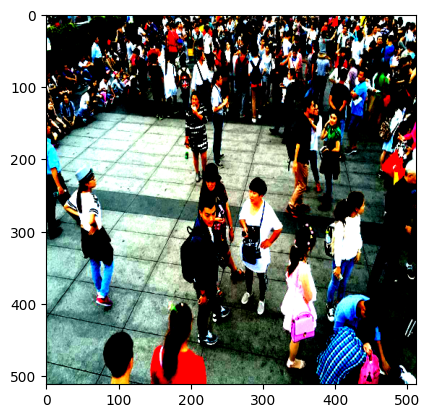

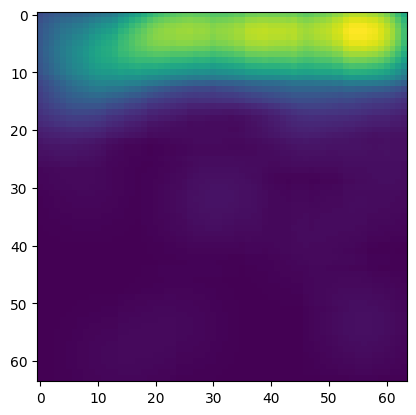

In [27]:
plt.imshow(train_images_for_csrnet[3])
plt.show()
plt.imshow(train_labels_for_csrnet[3])
plt.show()

In [193]:
train_ds_csrnet = tf.data.Dataset.from_tensor_slices((train_images_for_csrnet,train_labels_for_csrnet))


In [195]:
train_ds_csrnet_with_aug=(
    train_ds_csrnet
    .shuffle(buffer_size=64)
    .batch(16)
    .map(Augment())
    .prefetch(buffer_size=tf.data.AUTOTUNE)
)



In [28]:
train_ds_csrnet_no_aug=(
    train_ds_csrnet
    .shuffle(buffer_size=64)
    .batch(16)
    .prefetch(buffer_size=tf.data.AUTOTUNE)
)


In [196]:
val_ds_csrnet = [preprocess_data_for_csrnet_model(im,label) for im,label in zip(X_val,Y_val)]
val_images_csrnet = np.array([item[0] for item in val_ds_csrnet])
val_labels_csrnet = np.array([item[1] for item in val_ds_csrnet])
val_ds_csrnet = tf.data.Dataset.from_tensor_slices((val_images_csrnet,val_labels_csrnet))
val_ds_csrnet= val_ds_csrnet.batch(16).prefetch(buffer_size=tf.data.AUTOTUNE)

In [30]:
csrnet_model.compile(loss=custom_loss,optimizer=Adam(learning_rate = 1e-6),metrics='mae')

In [124]:
csrnet_checkpoint_path = './csrnet_with_aug.h5'
csrnet_history = csrnet_model.fit(
    train_ds_csrnet_with_aug,
    validation_data=val_ds_csrnet,
    epochs=15,
    callbacks=[create_checkpoint_callback(csrnet_checkpoint_path)]
)

Epoch 1/15
38/38 [==============================] - 52s 1s/step - loss: 1.1032 - mae: 0.0013 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 2/15
38/38 [==============================] - 51s 1s/step - loss: 1.1672 - mae: 0.0013 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 3/15
38/38 [==============================] - 51s 1s/step - loss: 1.0892 - mae: 0.0013 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 4/15
38/38 [==============================] - 51s 1s/step - loss: 1.0970 - mae: 0.0013 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 5/15
38/38 [==============================] - 51s 1s/step - loss: 1.0874 - mae: 0.0012 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 6/15
38/38 [==============================] - 51s 1s/step - loss: 1.0746 - mae: 0.0012 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 7/15
38/38 [==============================] - 51s 1s/step - loss: 1.0903 - mae: 0.0012 - val_loss: 1.6943 - val_mae: 0.0017
Epoch 8/15
38/38 [==============================] - 51s 1s/step - loss: 1.0627 - mae: 0.00

In [125]:
csrnet_model.load_weights(csrnet_checkpoint_path)

In [31]:
csrnet_history_2 = csrnet_model.fit(
        train_ds_csrnet_with_aug,
        validation_data=val_ds_csrnet,
        epochs=35,
        initial_epoch=csrnet_history.epoch[-1],
        callbacks=[create_checkpoint_callback(csrnet_checkpoint_path)]
)

Epoch 30/35
38/38 [==============================] - 51s 1s/step - loss: 2472.7749 - accuracy: 0.0014 - val_loss: 3650.6707 - val_accuracy: 0.1440
Epoch 31/35
38/38 [==============================] - 50s 1s/step - loss: 815.7838 - accuracy: 0.0020 - val_loss: 3727.2017 - val_accuracy: 0.1440
Epoch 32/35
38/38 [==============================] - 51s 1s/step - loss: 664.4300 - accuracy: 0.0026 - val_loss: 3702.6370 - val_accuracy: 0.1440
Epoch 33/35
38/38 [==============================] - 51s 1s/step - loss: 369.1183 - accuracy: 1.3021e-04 - val_loss: 3719.9451 - val_accuracy: 0.1440
Epoch 34/35
38/38 [==============================] - 51s 1s/step - loss: 41.1797 - accuracy: 0.0015 - val_loss: 3719.6995 - val_accuracy: 0.1440
Epoch 35/35
38/38 [==============================] - 51s 1s/step - loss: 286.9366 - accuracy: 0.0023 - val_loss: 2994.2527 - val_accuracy: 0.1440


In [32]:
csrnet_model.load_weights(csrnet_checkpoint_path)

In [126]:
csrnet_model.evaluate(test_ds_csrnet)

20/20 [==============================] - 4s 219ms/step - loss: 20.9176 - mae: 0.0302


[20.917634963989258, 0.030224764719605446]

## Testing CSRNET


In [37]:
val_images_B='./shanghaitech/ShanghaiTech/part_B/test_data/images/'
val_maps_B='./shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/'

In [38]:
val_images_B_path = Path(val_images_B)
val_maps_B_path = Path(val_maps_B)
images_list_B_test = sorted(list(val_images_B_path.glob(r"*.jpg")))
gt_list_B_test = sorted(list(val_maps_B_path.glob(r"*.mat")))

In [39]:
X_test = []
Y_test = []
for im_B_test,gt_B_test in zip(images_list_B_test,gt_list_B_test):
    X_test.append(str(im_B_test))
    Y_test.append(str(gt_B_test))
X_test = np.array(X_test)
Y_test = np.array(Y_test)

In [205]:

test_ds_csrnet = [preprocess_data_for_csrnet_model(im,label) for im,label in zip(X_test,Y_test)]
test_images_csrnet = np.array([item[0] for item in test_ds_csrnet])
test_labels_csrnet = np.array([item[1] for item in test_ds_csrnet])
test_ds_csrnet = tf.data.Dataset.from_tensor_slices((test_images_csrnet,test_labels_csrnet))
test_ds_csrnet= test_ds_csrnet.batch(16).prefetch(buffer_size=tf.data.AUTOTUNE)

In [40]:
test_ds = prepare_ds(X_test,Y_test)

In [208]:
def test_csrnet(index):
    test_image_path = str(images_list_B_test[index])
    test_mat_path = str(gt_list_B_test[index])
    # print(test_image_path,test_mat_path)
    test_img,test_label=preprocess_data_for_csrnet_model(test_image_path,test_mat_path)
    plt.imshow(test_img)
    plt.show()
    plt.imshow(test_label)
    plt.show()
    test = np.expand_dims(test_img,axis=0)
    return test,test_label

In [209]:
def show_csrnet_preds(model,index,cmap='jet'):
    test,test_label=test_csrnet(index)
    preds = model.predict(test)
    print(preds[0].shape)
    figure,axis = plt.subplots(1,3,figsize=(10,10))
    axis[0].imshow(test[0])
    axis[0].set_title("ORIGINAL")
    axis[1].imshow(test_label,cmap="jet")
    axis[1].set_title("Label")
    axis[2].imshow(preds[0],cmap=cmap)
    axis[2].set_title("PREDICTION")
    print("people in original image = "+str(np.sum(test_label)))
    print("people in pred image = "+ str(np.sum(preds[0])))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


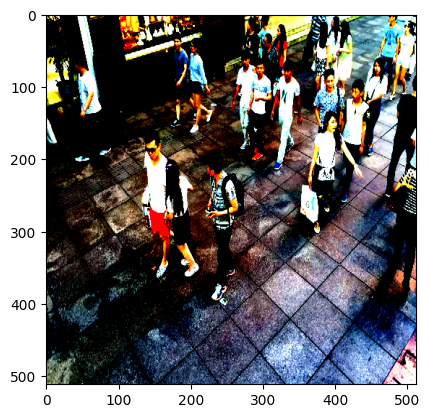

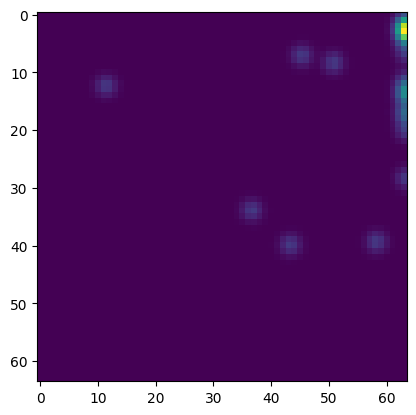

1/1 [==============================] - 0s 152ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(64, 64)


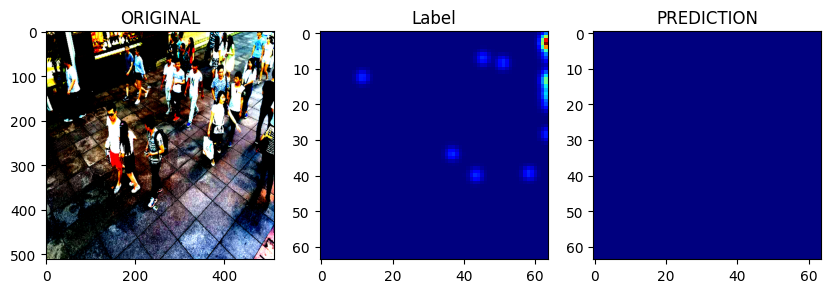

In [129]:
show_csrnet_preds(csrnet_model,0)

In [41]:
csrnet_model.compile(loss='mse',optimizer=Adam(learning_rate = 1e-4),metrics='mae')

In [42]:
csrnet_checkpoint_no_aug_path = './csrnet_no_aug.h5'
csrnet_history = csrnet_model.fit(
    train_ds_csrnet_no_aug,
    validation_data=val_ds_csrnet,
    epochs=10,
    callbacks=[create_checkpoint_callback(csrnet_checkpoint_no_aug_path),create_reduceLrOnPlateau()]
)

Epoch 1/10
38/38 [==============================] - 26s 674ms/step - loss: 4.2491e-05 - mae: 0.0013 - val_loss: 58.0119 - val_mae: 0.0423 - lr: 1.0000e-04
Epoch 2/10
38/38 [==============================] - 26s 681ms/step - loss: 4.2491e-05 - mae: 0.0013 - val_loss: 58.0119 - val_mae: 0.0423 - lr: 1.0000e-04
Epoch 3/10
38/38 [==============================] - 26s 690ms/step - loss: 4.2491e-05 - mae: 0.0013 - val_loss: 58.0119 - val_mae: 0.0423 - lr: 1.0000e-04
Epoch 4/10
38/38 [==============================] - 26s 692ms/step - loss: 4.2491e-05 - mae: 0.0013 - val_loss: 58.0119 - val_mae: 0.0423 - lr: 1.0000e-04
Epoch 5/10
38/38 [==============================] - 26s 693ms/step - loss: 4.2491e-05 - mae: 0.0013 - val_loss: 58.0119 - val_mae: 0.0423 - lr: 1.0000e-05
Epoch 6/10
38/38 [==============================] - 26s 692ms/step - loss: 4.2491e-05 - mae: 0.0013 - val_loss: 58.0119 - val_mae: 0.0423 - lr: 1.0000e-05
Epoch 7/10
38/38 [==============================] - 26s 694ms/step - l

In [48]:
csrnet_model.load_weights(csrnet_checkpoint_no_aug_path)

In [56]:
csrnet_model.evaluate(test_ds_csrnet)

20/20 [==============================] - 8s 376ms/step - loss: 13.2719 - mae: 0.0152


[13.271856307983398, 0.015204356983304024]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


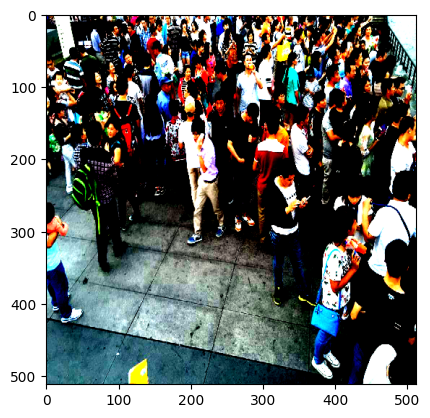

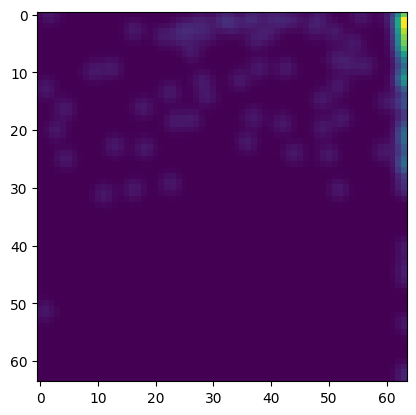

1/1 [==============================] - 1s 852ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(64, 64)


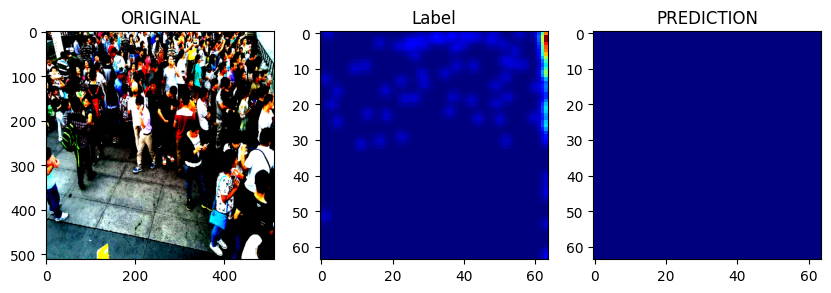

In [57]:
show_csrnet_preds(csrnet_model,10)

# Testing

In [36]:
def test_model(index,from_scipy=False):
    test_image_path = str(images_list_B_test[index])
    test_mat_path = str(gt_list_B_test[index])
    print(test_image_path,test_mat_path)
    test_img,test_im_shape = preprocess_images(test_image_path)
    plt.imshow(test_img)
    plt.show()
    test_label = preprocess_labels(test_mat_path,test_im_shape,from_scipy)
    plt.imshow(test_label)
    plt.show()
    test = np.expand_dims(test_img,axis=0)
    print(str(np.sum(test_label)))
    return test,test_label

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


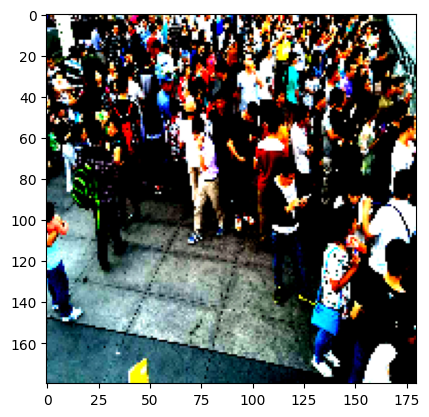

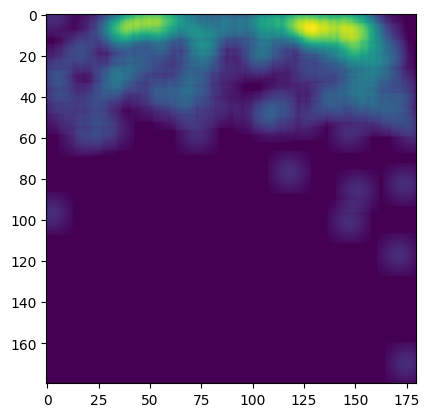

138.99999999999997


In [41]:
test,test_label=test_model(10,from_scipy=False)

1/1 [==============================] - 0s 314ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)


Text(0.5, 1.0, 'PREDICTION')

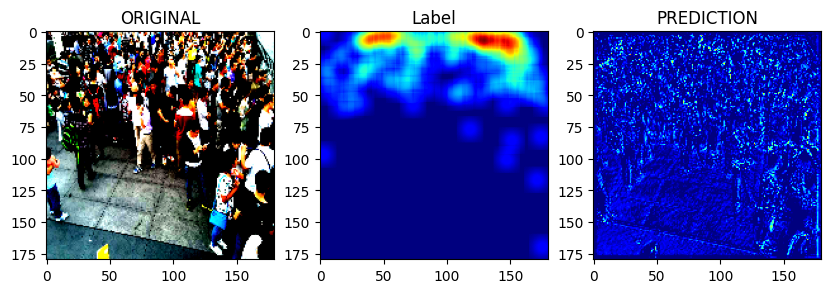

In [42]:
preds = Auto_Encoder.predict(test)
print(preds[0].shape)
figure,axis = plt.subplots(1,3,figsize=(10,10))
axis[0].imshow(test[0])
axis[0].set_title("ORIGINAL")
axis[1].imshow(test_label,cmap="jet")
axis[1].set_title("Label")
axis[2].imshow(preds[0],cmap="jet")
axis[2].set_title("PREDICTION")

In [43]:
def show_model_preds(model,index,cmap='jet'):
    test,test_label=test_model(index)
    preds = model.predict(test)
    print(preds[0].shape)
    figure,axis = plt.subplots(1,3,figsize=(10,10))
    axis[0].imshow(test[0])
    axis[0].set_title("ORIGINAL")
    axis[1].imshow(test_label,cmap="jet")
    axis[1].set_title("Label")
    axis[2].imshow(preds[0],cmap=cmap)
    axis[2].set_title("PREDICTION")
    print("people in original image = "+str(np.sum(test_label)))
    print("people in pred image = "+ str(np.sum(preds[0])))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_110.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_110.mat


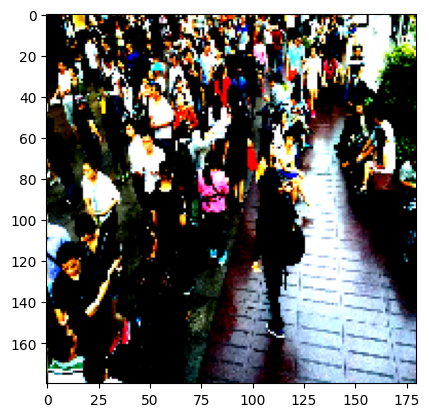

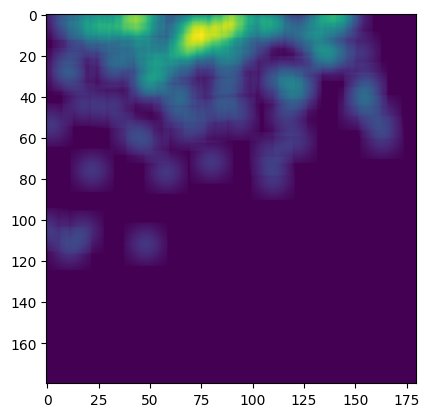

110.00000000000001
1/1 [==============================] - 0s 19ms/step
(180, 180, 1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


people in original image = 110.00000000000001
people in pred image = 974.8683


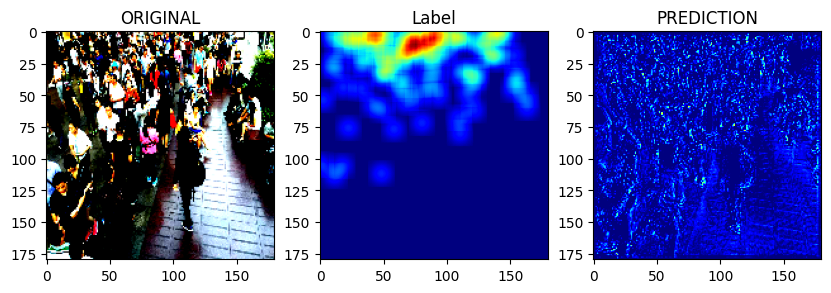

In [44]:
show_model_preds(Auto_Encoder,13)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_1.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_1.mat


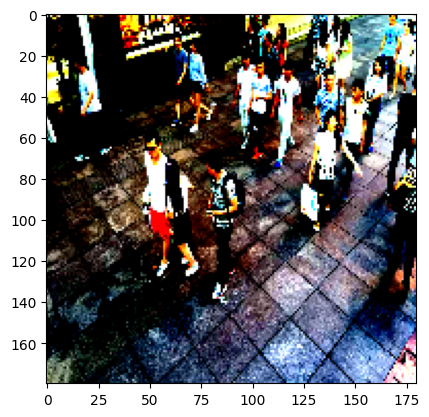

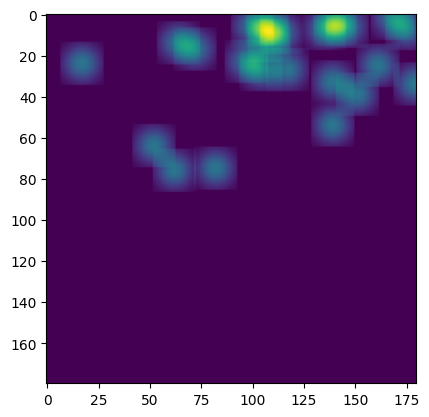

23.0
1/1 [==============================] - 0s 18ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 23.0
people in pred image = 1082.5201


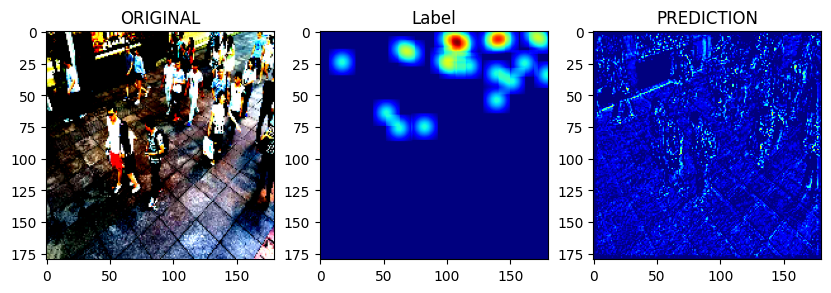

In [45]:
show_model_preds(Auto_Encoder,0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_103.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_103.mat


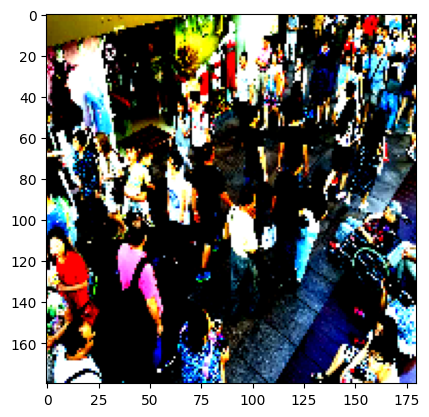

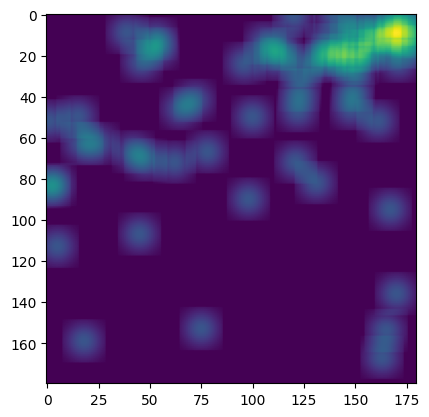

57.0
1/1 [==============================] - 0s 16ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 57.0
people in pred image = 1006.16693


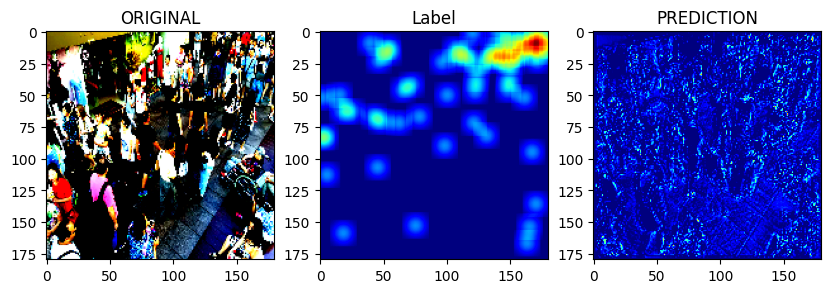

In [46]:
show_model_preds(Auto_Encoder,5)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_103.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_103.mat


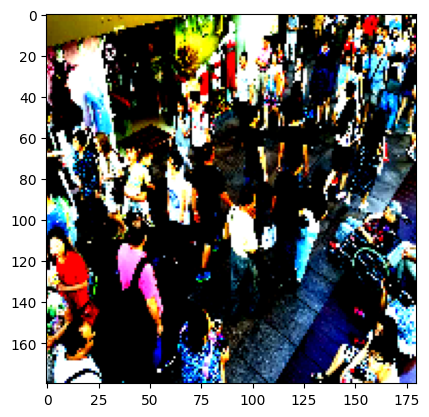

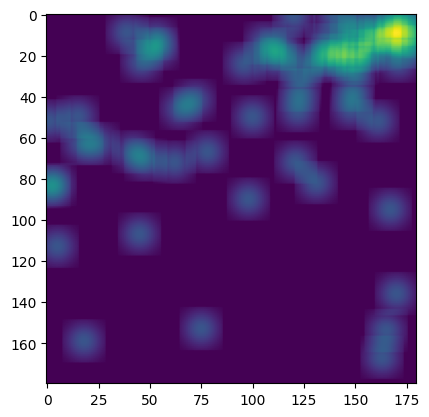

57.0
1/1 [==============================] - 0s 17ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 57.0
people in pred image = 1006.1669


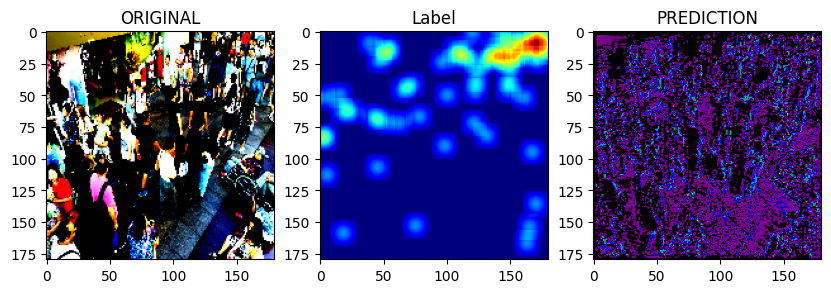

In [47]:
show_model_preds(Auto_Encoder,5,cmap='nipy_spectral')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_106.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_106.mat


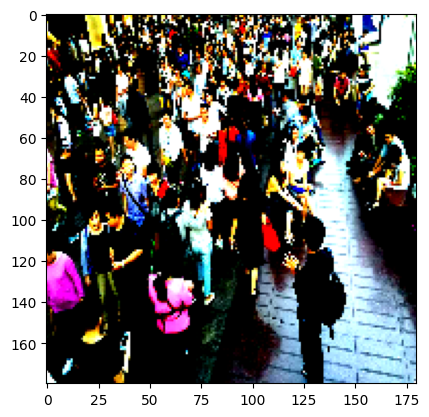

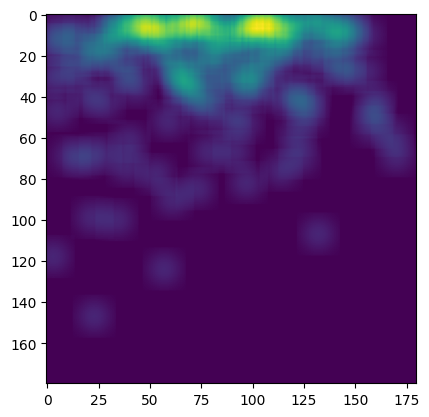

165.0
1/1 [==============================] - 0s 17ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 165.0
people in pred image = 1018.014


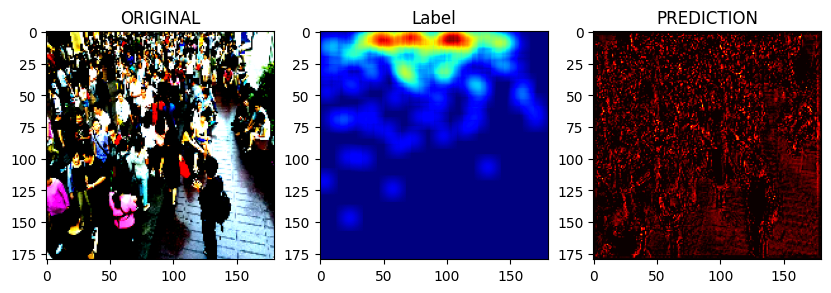

In [48]:
show_model_preds(Auto_Encoder,8,cmap='hot')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_106.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_106.mat


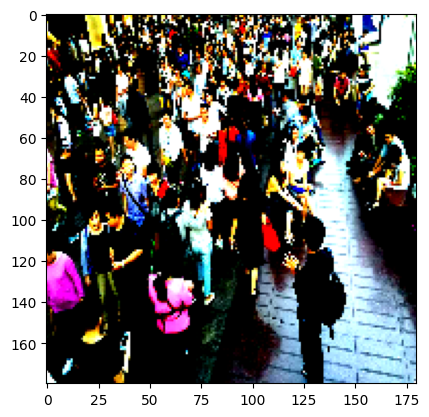

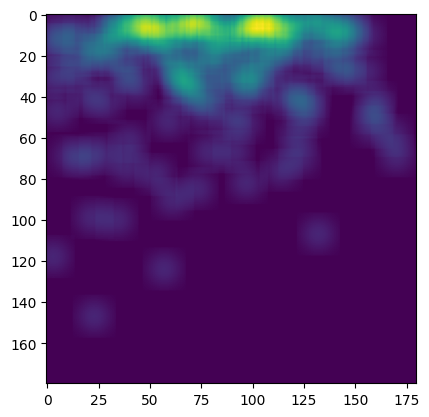

165.0
1/1 [==============================] - 0s 16ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 165.0
people in pred image = 1018.014


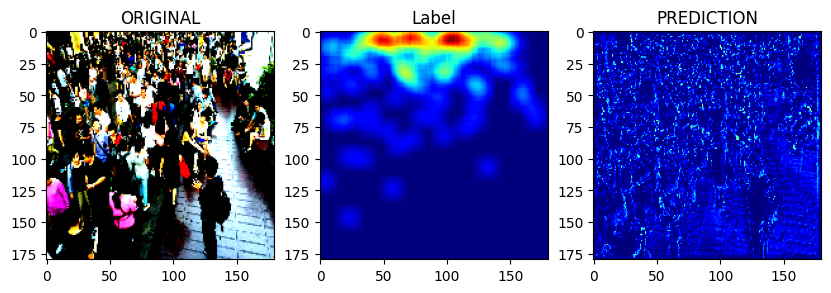

In [49]:
show_model_preds(Auto_Encoder,8,cmap='jet')

# Lets try another autoencoder

In [50]:
def another_auto_encoder(INPUT_DIM):
    encoder_input = Input(shape=(INPUT_DIM,INPUT_DIM,3))
    #
    x = Conv2D(32,(2,2),kernel_initializer = 'he_normal')(encoder_input)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)
    #
    x = Conv2D(64,(2,2),kernel_initializer = 'he_normal')(x)
    x = BatchNormalization()(x)
    encoder_output = LeakyReLU()(x)
    encoder = Model(inputs=encoder_input,outputs=encoder_output)

    decoder_input = Input(shape=encoder.output.shape[1:])
    #
    y = Conv2DTranspose(32,(2,2))(decoder_input)
    y = LeakyReLU()(y)
    #
    y = Conv2DTranspose(output_class,(2,2))(y)
    decoder_output = LeakyReLU()(y)
    decoder = Model(inputs=decoder_input,outputs=decoder_output)

    ae_input = Input(shape=(INPUT_DIM,INPUT_DIM,3))
    z = encoder(ae_input)
    ae_output = decoder(z)
    Auto_Encoder_2 = Model(inputs=ae_input,outputs=ae_output)
    return Auto_Encoder_2


In [51]:
Auto_Encoder_2 = another_auto_encoder(INPUT_DIM)
Auto_Encoder_2.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 model (Functional)          (None, 178, 178, 64)      9056      
                                                                 
 model_1 (Functional)        (None, 180, 180, 1)       8353      
                                                                 
Total params: 17,409
Trainable params: 17,217
Non-trainable params: 192
_________________________________________________________________


In [52]:
Auto_Encoder_2.compile(loss="mse",optimizer=RMSprop(learning_rate=0.000001))

In [53]:
Auto_Encoder_2_history = Auto_Encoder_2.fit(
    train_ds_scipy,
    validation_data=val_ds_scipy,
    epochs=50
)

Epoch 1/50
38/38 [==============================] - 4s 87ms/step - loss: 130.8055 - val_loss: 0.0614
Epoch 2/50
38/38 [==============================] - 3s 86ms/step - loss: 63.9445 - val_loss: 0.0635
Epoch 3/50
38/38 [==============================] - 3s 84ms/step - loss: 127.7657 - val_loss: 0.0735
Epoch 4/50
38/38 [==============================] - 3s 82ms/step - loss: 145.6792 - val_loss: 0.0859
Epoch 5/50
38/38 [==============================] - 3s 87ms/step - loss: 111.2192 - val_loss: 0.1032
Epoch 6/50
38/38 [==============================] - 3s 83ms/step - loss: 92.4767 - val_loss: 0.1233
Epoch 7/50
38/38 [==============================] - 3s 86ms/step - loss: 101.7356 - val_loss: 0.1449
Epoch 8/50
38/38 [==============================] - 3s 81ms/step - loss: 110.0945 - val_loss: 0.1632
Epoch 9/50
38/38 [==============================] - 3s 82ms/step - loss: 119.0932 - val_loss: 0.1802
Epoch 10/50
38/38 [==============================] - 3s 83ms/step - loss: 90.9488 - val_loss:

shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_106.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_106.mat


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


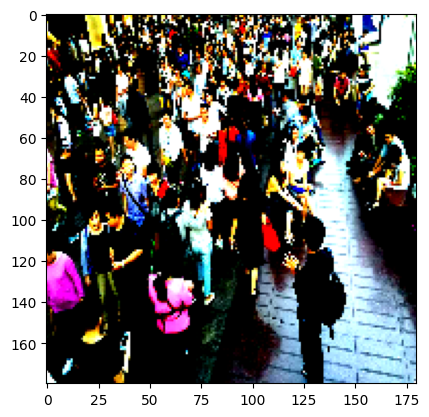

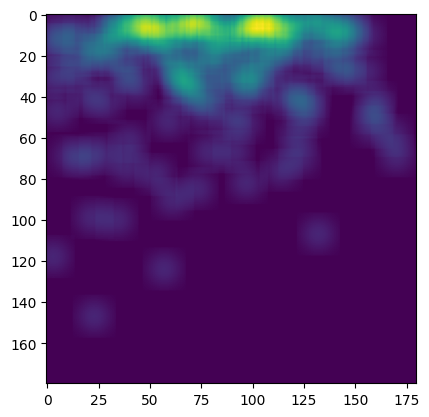

165.0
1/1 [==============================] - 0s 76ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 165.0
people in pred image = 7631.5693


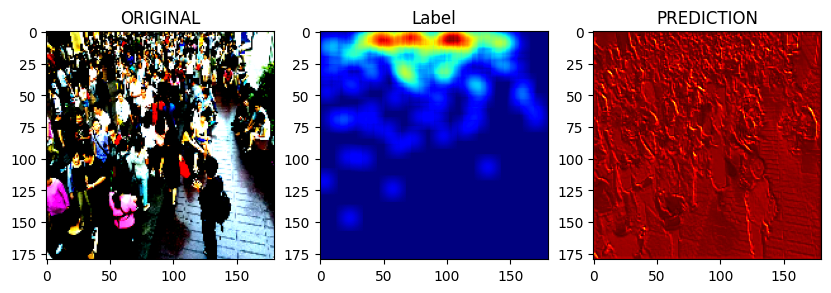

In [54]:
show_model_preds(Auto_Encoder_2,8,cmap='hot')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_106.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_106.mat


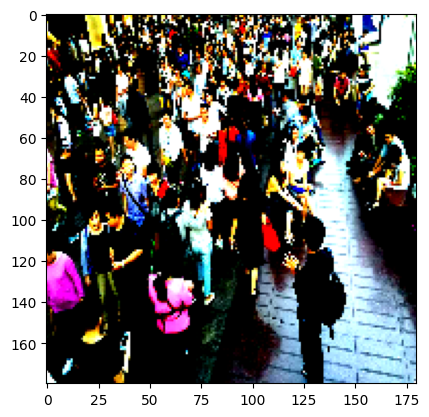

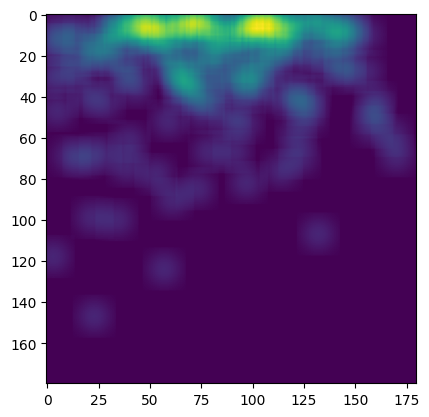

165.0
1/1 [==============================] - 0s 15ms/step
(180, 180, 1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


people in original image = 165.0
people in pred image = 7631.5693


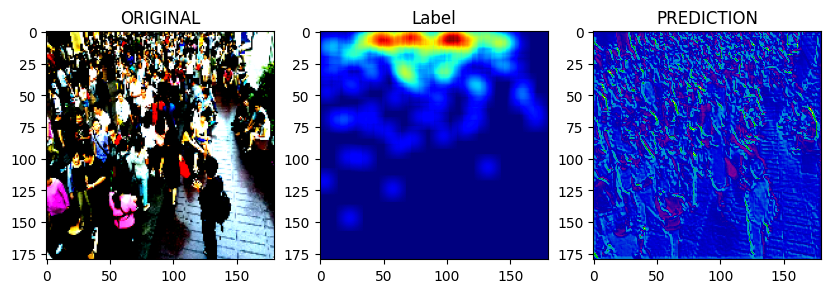

In [55]:
show_model_preds(Auto_Encoder_2,8,cmap='nipy_spectral')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_126.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_126.mat


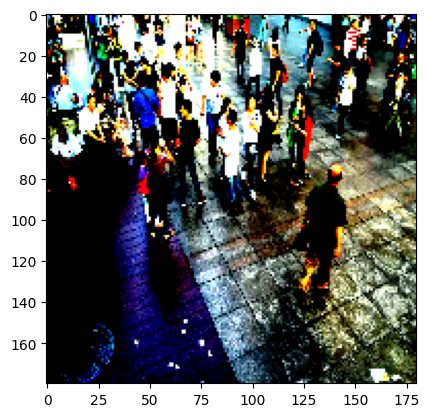

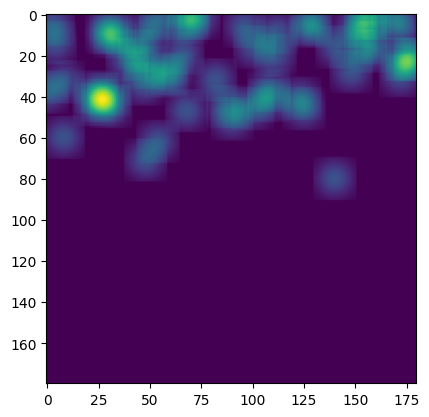

56.0
1/1 [==============================] - 0s 17ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 56.0
people in pred image = 7223.0767


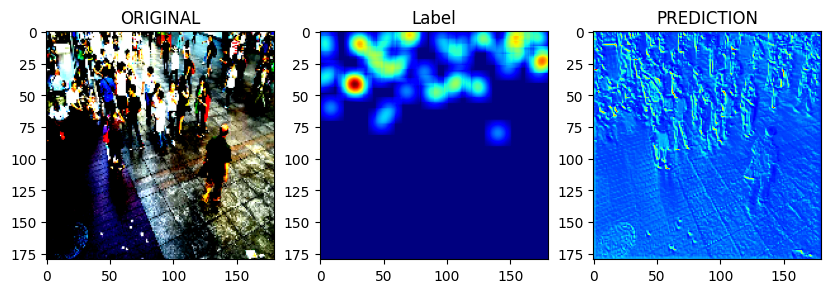

In [56]:
show_model_preds(Auto_Encoder_2,30)

# Lets try out another CNN architecture

## MCNN

In [57]:
def MCNN(input_shape=(INPUT_DIM,INPUT_DIM,3)):
    inputs = Input(shape=input_shape)

    # column 1
    column_1 = Conv2D(16, (9, 9), padding='same', activation='relu')(inputs)
    column_1 = MaxPooling2D(2)(column_1)
    column_1 = Conv2D(32, (7, 7), padding='same', activation='relu')(column_1)
    column_1 = MaxPooling2D(2)(column_1)
    column_1 = Conv2D(16, (7, 7), padding='same', activation='relu')(column_1)
    column_1 = Conv2D(8, (7, 7), padding='same', activation='relu')(column_1)

    # column 2
    column_2 = Conv2D(20, (7, 7), padding='same', activation='relu')(inputs)
    column_2 = MaxPooling2D(2)(column_2)
    column_2 = Conv2D(40, (5, 5), padding='same', activation='relu')(column_2)
    column_2 = MaxPooling2D(2)(column_2)
    column_2 = Conv2D(20, (5, 5), padding='same', activation='relu')(column_2)
    column_2 = Conv2D(10, (5, 5), padding='same', activation='relu')(column_2)

    # column 3
    column_3 = Conv2D(24, (5, 5), padding='same', activation='relu')(inputs)
    column_3 = MaxPooling2D(2)(column_3)
    column_3 = Conv2D(48, (3, 3), padding='same', activation='relu')(column_3)
    column_3 = MaxPooling2D(2)(column_3)
    column_3 = Conv2D(24, (3, 3), padding='same', activation='relu')(column_3)
    column_3 = Conv2D(12, (3, 3), padding='same', activation='relu')(column_3)

    # merge feature map of 3 columns in last dimension
    merges = Concatenate(axis=-1)([column_1, column_2, column_3])
    # density map
    density_map = Conv2D(1, (1, 1), padding='same')(merges)
    density_map = Resizing(height=INPUT_DIM,width=INPUT_DIM)(density_map)
    
    model = Model(inputs=inputs, outputs=density_map)
    return model

In [58]:
mcnn = MCNN()
mcnn.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_10 (Conv2D)             (None, 180, 180, 16  3904        ['input_9[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_14 (Conv2D)             (None, 180, 180, 20  2960        ['input_9[0][0]']                
                                )                                                           

In [59]:
mcnn.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=['mae'])

In [60]:
mcnn_history = mcnn.fit(
    train_ds_scipy,
    validation_data=val_ds_scipy,
    epochs=30
)

Epoch 1/30
38/38 [==============================] - 5s 96ms/step - loss: 112.5037 - mae: 7.5697 - val_loss: 0.7689 - val_mae: 0.8288
Epoch 2/30
38/38 [==============================] - 3s 82ms/step - loss: 121.9017 - mae: 8.0778 - val_loss: 2.0391 - val_mae: 1.3539
Epoch 3/30
38/38 [==============================] - 3s 81ms/step - loss: 94.8021 - mae: 7.0448 - val_loss: 4.5940 - val_mae: 2.0269
Epoch 4/30
38/38 [==============================] - 3s 82ms/step - loss: 84.8715 - mae: 6.4574 - val_loss: 8.4566 - val_mae: 2.7407
Epoch 5/30
38/38 [==============================] - 3s 81ms/step - loss: 122.9682 - mae: 8.0648 - val_loss: 19.3162 - val_mae: 4.1311
Epoch 6/30
38/38 [==============================] - 3s 82ms/step - loss: 101.1718 - mae: 7.3500 - val_loss: 26.9820 - val_mae: 4.8736
Epoch 7/30
38/38 [==============================] - 3s 82ms/step - loss: 89.3910 - mae: 6.8804 - val_loss: 31.5495 - val_mae: 5.2682
Epoch 8/30
38/38 [==============================] - 3s 81ms/step - lo

In [61]:
mcnn.evaluate(test_ds)

20/20 [==============================] - 0s 20ms/step - loss: 308.8629 - mae: 16.0081


[308.8629150390625, 16.008132934570312]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_102.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_102.mat


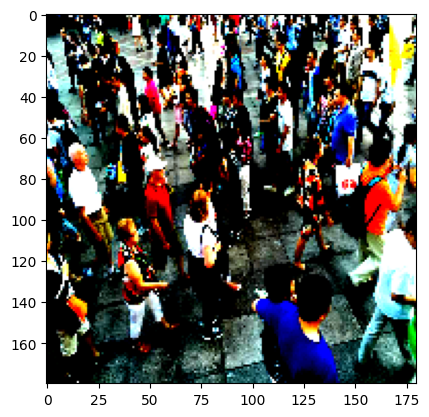

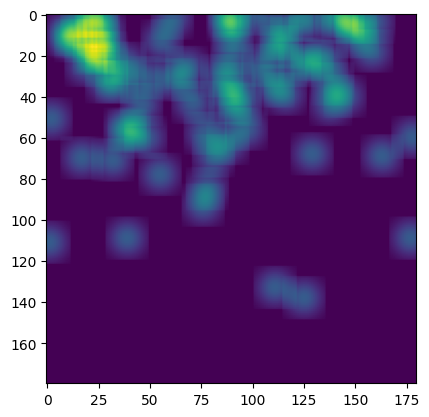

69.99999999999999
1/1 [==============================] - 0s 204ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 69.99999999999999
people in pred image = 541053.9


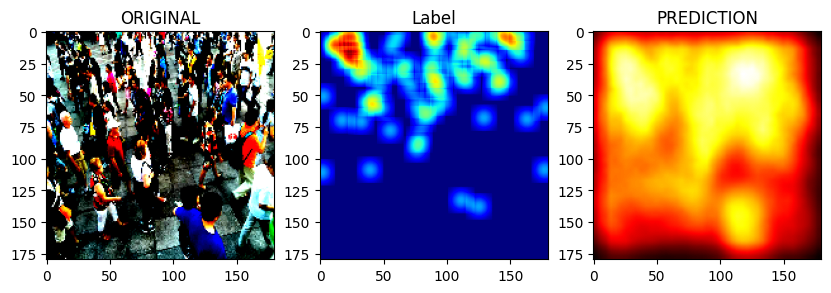

In [62]:
show_model_preds(mcnn,4,cmap='hot')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_112.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_112.mat


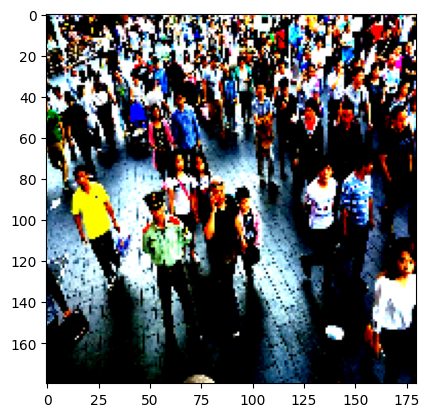

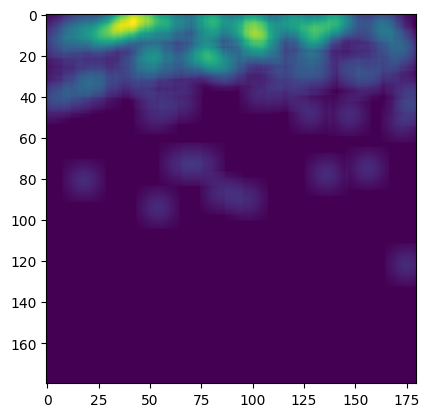

131.0
1/1 [==============================] - 0s 16ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 131.0
people in pred image = 563163.4


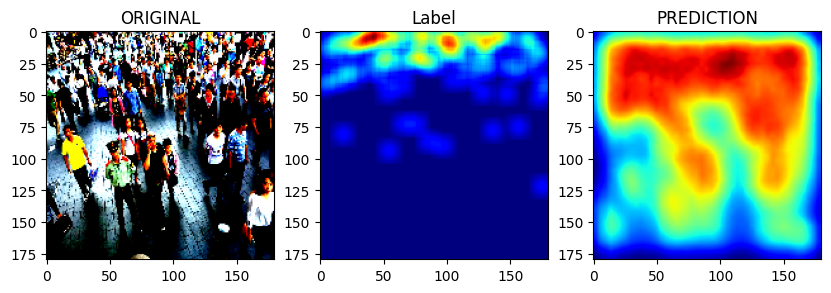

In [64]:
show_model_preds(mcnn,15)

## Trying a new data augmentation technique
New Data Augmentation Technique
Patch Extraction:

1. Patch Selection: The first step is to select multiple patches from an input image. These patches can be non-overlapping sections of the image, typically rectangular or square in shape.
2. Corresponding Labels: For each selected patch from the image, there should also be a corresponding patch selected from the ground truth density map (label) that represents the head counts within that patch. This ensures that the labels align with the patches.
3. Shuffling: After selecting patches from multiple images in your dataset, you shuffle these patches randomly. This shuffling step is essential to prevent the model from learning spatial dependencies that might exist between patches within the same image.
4. Mixing: Now, you mix the shuffled patches together to create new images and their corresponding labels. The idea is to generate synthetic training examples by combining patches from different images. This process introduces diversity into the training data.
5. Label Adjustment: When you mix patches, you need to adjust the corresponding labels accordingly. For example, if you mix two patches from different images, the label for the new image should represent the combined head counts from the two original patches.

### Benefits of this Technique:

 1. Increased Diversity: By mixing patches from different images, you increase the diversity of training data. This helps the model generalize better to different crowd scenarios.

2. Data Efficiency: This technique allows you to create more training examples without the need for additional data collection. It effectively expands your dataset.

3. Robustness: The shuffled and mixed patches help the model learn crowd counting in a more robust way, as it is exposed to a wider range of spatial arrangements of people.

### Considerations

1. Patch Size: The size and shape of the patches are important considerations. The patch size should be chosen carefully to balance between capturing local details and allowing for sufficient mixing.

2. Overlap: You can experiment with less or more overlapping patches to capture more context.

3. Hyperparameter Tuning: The parameters used in this technique, such as the number of patches to extract and the patch size, may need to be fine-tuned based on your specific dataset and model architecture.

In [65]:
def get_rand(min_val,max_val):
    return tf.random.uniform((1,),minval=min_val,maxval=max_val,dtype=tf.int32)[0].numpy()

In [66]:
get_rand(0,4)

0

In [67]:
def get_9_patches(image_shape):
    h,w = image_shape[0],image_shape[1]
    patch_1 = np.array([h//8,w//8,0,0])
    patch_2 = np.array([h//8,w//2,0,0])
    patch_3 = np.array([h//2,w//8,0,0])
    patch_4 = np.array([h//2,w//2,0,0])
    
    h75 = int(h*0.75)
    w75 = int(w*0.75)
    patch_5 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_6 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_7 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_8 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_9 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    
    patches = np.array([patch_1,patch_2,patch_3,patch_4,patch_5,patch_6,patch_7,patch_8,patch_9])
    for patch in patches:
        patch[2] = patch[0]+h//4
        patch[3] = patch[1]+w//4
    
    patches = tf.random.shuffle(patches)
    return patches

In [68]:
patches=get_9_patches((INPUT_DIM,INPUT_DIM,3))
patches

<tf.Tensor: shape=(9, 4), dtype=int64, numpy=
array([[129,   2, 174,  47],
       [  4,  20,  49,  65],
       [ 22,  22,  67,  67],
       [ 90,  90, 135, 135],
       [ 22,  90,  67, 135],
       [ 16, 131,  61, 176],
       [ 50,   7,  95,  52],
       [ 82,  39, 127,  84],
       [ 90,  22, 135,  67]])>

In [69]:
def get_16_patches(image_shape):
    h,w = image_shape[0],image_shape[1]
    patch_1 = np.array([h//8,w//8,0,0])
    patch_2 = np.array([h//8,w//2,0,0])
    patch_3 = np.array([h//2,w//8,0,0])
    patch_4 = np.array([h//2,w//2,0,0])
    
    h75 = int(h*0.75)
    w75 = int(w*0.75)
    patch_5 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_6 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_7 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_8 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_9 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_10 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_11 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_12 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_13 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_14 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_15 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    patch_16 = np.array([get_rand(0,h75),get_rand(0,w75),0,0])
    
    
    patches = np.array([patch_1,patch_2,patch_3,patch_4,patch_5,patch_6,patch_7,
                        patch_8,patch_9,patch_10,patch_11,patch_12,patch_13,
                        patch_14,patch_15,patch_16
                       ])
    for patch in patches:
        patch[2] = patch[0]+h//4
        patch[3] = patch[1]+w//4
    
    patches = tf.random.shuffle(patches)
    return patches

In [70]:
patches=get_16_patches((INPUT_DIM,INPUT_DIM,3))
patches

<tf.Tensor: shape=(16, 4), dtype=int64, numpy=
array([[ 90,  90, 135, 135],
       [ 73, 134, 118, 179],
       [ 18,  10,  63,  55],
       [114, 118, 159, 163],
       [ 22,  90,  67, 135],
       [ 90,  22, 135,  67],
       [103,  30, 148,  75],
       [102,   7, 147,  52],
       [121, 115, 166, 160],
       [ 25,  57,  70, 102],
       [ 70,  32, 115,  77],
       [ 82,  52, 127,  97],
       [ 31,  99,  76, 144],
       [ 39, 115,  84, 160],
       [ 22,  22,  67,  67],
       [ 56,  39, 101,  84]])>

In [71]:
def get_image_patches(img,mat,is_nine=True):
    if is_nine:
        patches = get_9_patches(img.shape)
    else:
        patches = get_16_patches(img.shape)
    img_patches = []
    mat_patches = []
    for patch in patches:
        img_patches.append(img[patch[0]:patch[2],patch[1]:patch[3]])
        mat_patches.append(mat[patch[0]:patch[2],patch[1]:patch[3]])
    return tf.constant(img_patches),tf.constant(mat_patches)

In [72]:
test_img,test_im_shape = preprocess_images(str(images_list_B_test[4]))
test_label = preprocess_labels(str(gt_list_B_test[4]),test_im_shape,False)
img_patches,mat_patches=get_image_patches(test_img,test_label)
img_patches.shape,mat_patches.shape

(TensorShape([9, 45, 45, 3]), TensorShape([9, 45, 45]))

In [73]:
def create_image_from_patches_helper(h,w,num,img_patches,mat_patches):
    new_img = np.zeros(shape=(num*h,num*w,3))
    new_mat = np.zeros(shape=(num*h,num*w))
    for i in range(num):
        for j in range(num):
            new_img[j*h:(j+1)*h , i*w:(i+1)*w] = img_patches[num*i+j]
            new_mat[j*h:(j+1)*h , i*w:(i+1)*w] = mat_patches[num*i+j]
    return new_img,new_mat

In [74]:
def create_images_from_patches(img,mat,is_nine=True):
    img_patches,mat_patches=get_image_patches(img,mat,is_nine)
    h,w = img_patches.shape[1:3]
    if is_nine:
        new_img,new_mat=create_image_from_patches_helper(h,w,3,img_patches,mat_patches)
        new_img = cv2.resize(new_img,(img.shape[0],img.shape[1]))
        new_mat = cv2.resize(new_mat,(img.shape[0],img.shape[1]))
    else:
        new_img,new_mat=create_image_from_patches_helper(h,w,4,img_patches,mat_patches)
    return new_img,new_mat

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


people in original matrix: 69.99999999999999
people in patches matrix: 63.44804694951296


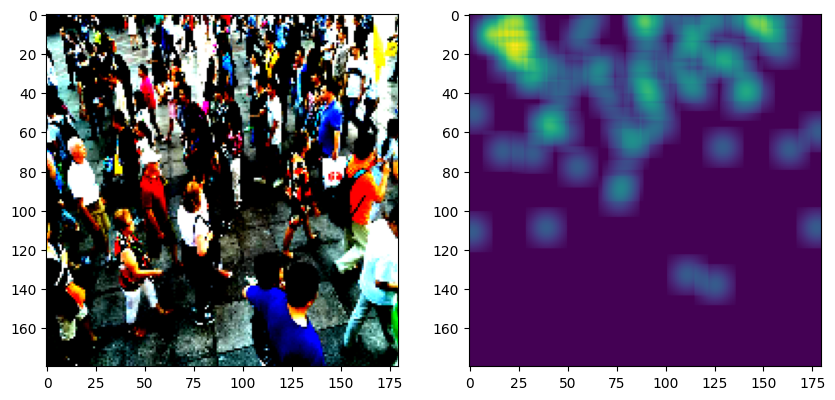

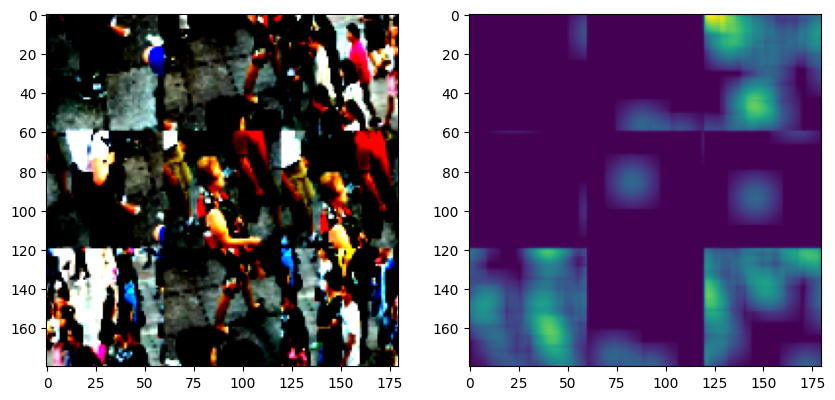

In [75]:
new_img,new_mat=create_images_from_patches(test_img,test_label,is_nine=True)
fig,axes = plt.subplots(1,2,figsize=(10,10))
axes[0].imshow(test_img)
print("people in original matrix: "+str(np.sum(test_label)))
axes[1].imshow(test_label)
fig,axes = plt.subplots(1,2,figsize=(10,10))
axes[0].imshow(new_img)
print("people in patches matrix: "+str(np.sum(new_mat)))
axes[1].imshow(new_mat)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


people in original matrix: 69.99999999999999
people in patches matrix: 72.10540195530115


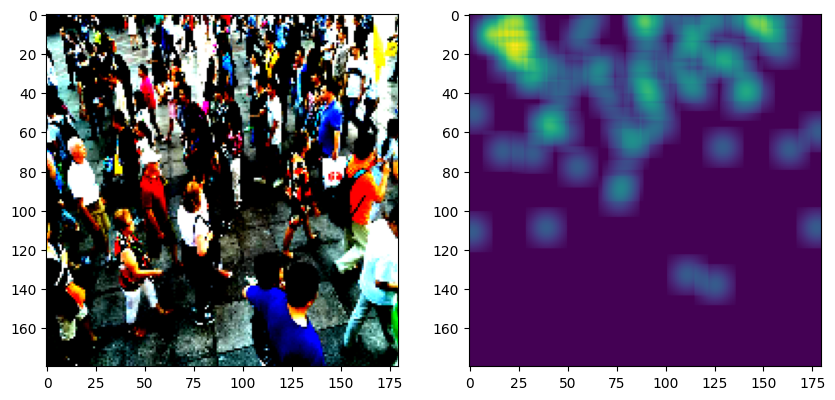

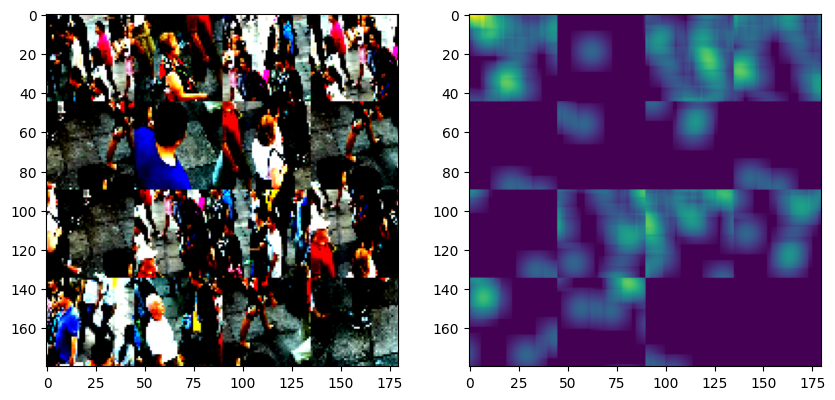

In [76]:
new_img,new_mat=create_images_from_patches(test_img,test_label,is_nine=False)
fig,axes = plt.subplots(1,2,figsize=(10,10))
axes[0].imshow(test_img)
print("people in original matrix: "+str(np.sum(test_label)))
axes[1].imshow(test_label)
fig,axes = plt.subplots(1,2,figsize=(10,10))
axes[0].imshow(new_img)
print("people in patches matrix: "+str(np.sum(new_mat)))
axes[1].imshow(new_mat)

In [77]:
def see_patches(idx,is_nine=True):
    test_img,test_im_shape = preprocess_images(str(images_list_B_test[idx]))
    test_label = preprocess_labels(str(gt_list_B_test[idx]),test_im_shape,False)
    new_img,new_mat=create_images_from_patches(test_img,test_label,is_nine)
    fig,axes = plt.subplots(1,2,figsize=(10,10))
    axes[0].imshow(test_img)
    axes[1].imshow(test_label)
    fig,axes = plt.subplots(1,2,figsize=(10,10))
    axes[0].imshow(new_img)
    axes[1].imshow(new_mat)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


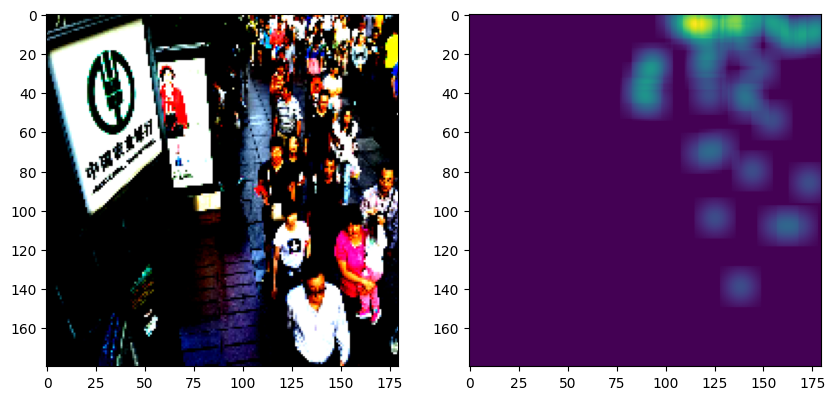

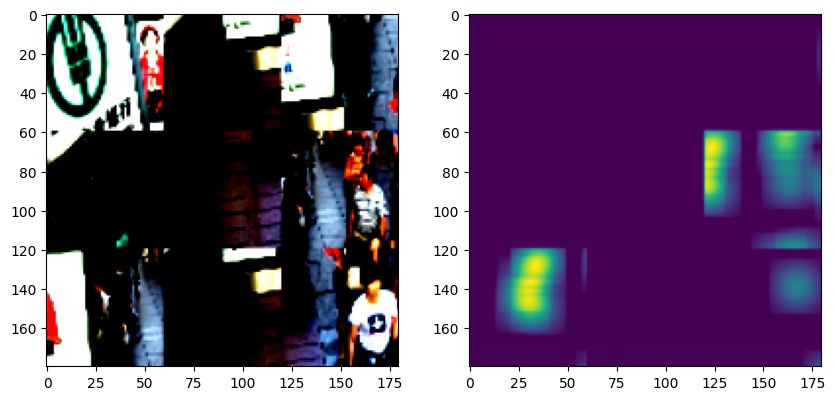

In [78]:
see_patches(20)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


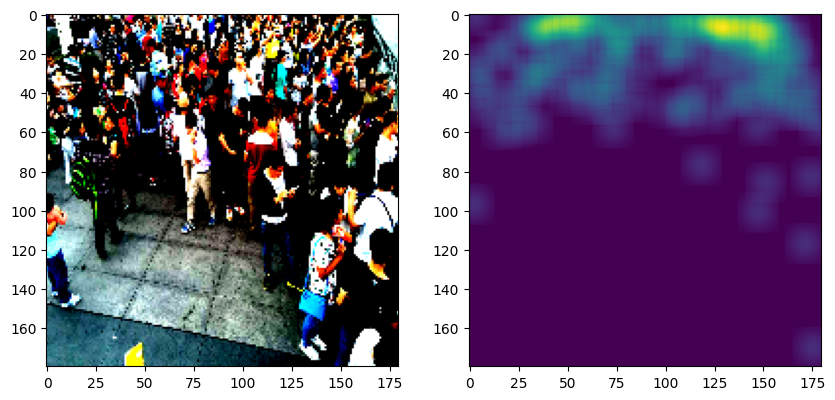

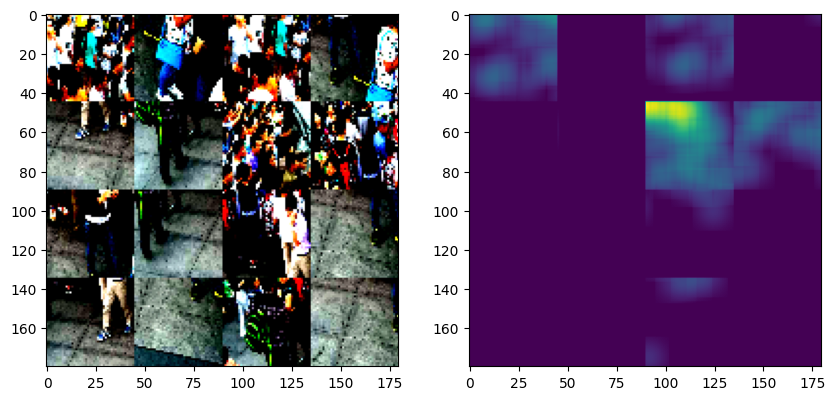

In [79]:
see_patches(10,False)

## Now lets prepare a new dataset for training

In [214]:
INPUT_DIM = 180
BATCH_SIZE = 16

In [80]:
def prepare_ds_with_patches(x,y,shuffle=False,augment=False,from_scipy=False,use_patches=False,is_nine=True):
    ds = [preprocess_data(im,label,from_scipy) for im,label in zip(x,y)]
    imgs = [item[0] for item in ds]
    mats = [item[1] for item in ds]
    print(len(imgs))
    print(len(mats))
    imgs_copy = imgs[:]
    mats_copy = mats[:]
    if use_patches:
        for img,mat in zip(imgs_copy,mats_copy):
            new_img,new_mat=create_images_from_patches(img,mat,is_nine)
            imgs.append(new_img)
            mats.append(new_mat)
            # print(len(imgs),len(mats))
    imgs = np.array(imgs)
    mats = np.array(mats)
    print(imgs.shape)
    print(mats.shape)
    ds = tf.data.Dataset.from_tensor_slices((imgs,mats))
    if shuffle:
        ds = ds.shuffle(buffer_size=64)
    
    ds = ds.batch(BATCH_SIZE)
    
    if augment:
        ds = ds.map(Augment())
    
    ds = ds.prefetch(buffer_size=tf.data.AUTOTUNE)
    return ds

In [81]:
train_ds_with_patches = prepare_ds_with_patches(
    X_train,
    Y_train,
    shuffle=True,
    augment=True,
    from_scipy=False,
    use_patches=True
)

600
600
(1200, 180, 180, 3)
(1200, 180, 180)


In [82]:
len(train_ds_with_patches)

75

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


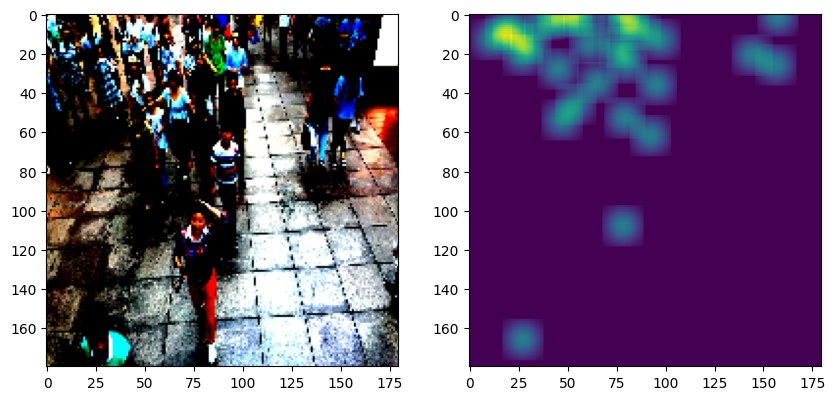

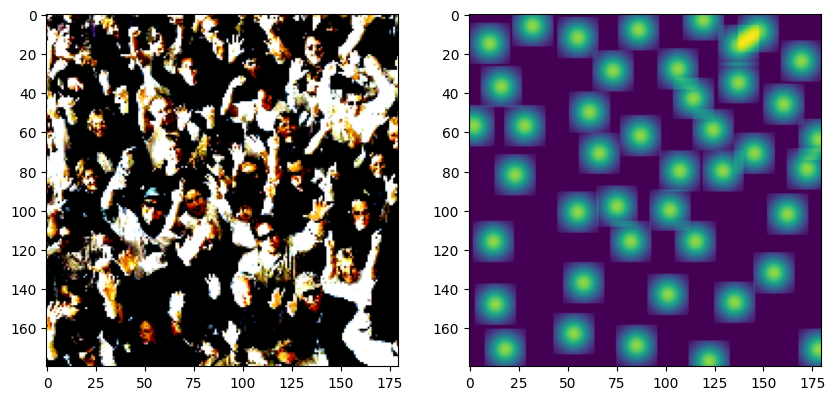

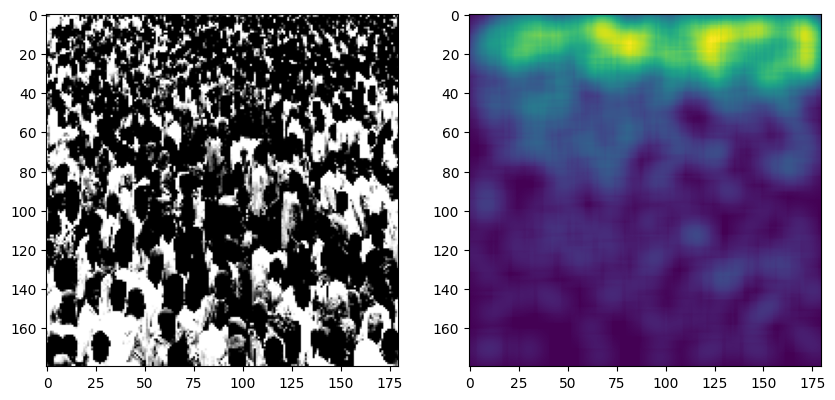

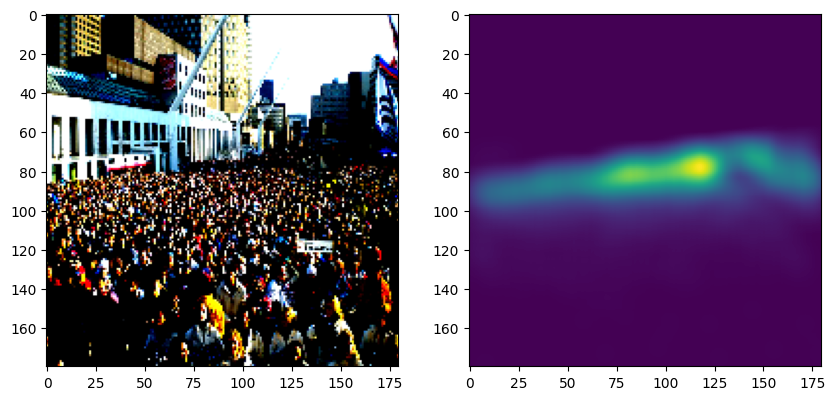

In [83]:
j=0
for f,g in train_ds_with_patches.take(2).unbatch():
    fig,axes = plt.subplots(1,2,figsize=(10,10))
    axes[0].imshow(f)
    axes[1].imshow(g)
    j+=1
    if j>3:
        break

## Prepare val ds

In [84]:
val_ds = prepare_ds(X_val,Y_val)

## Let's try out some of the previous model again

### Auto Encoder 1

In [85]:
encoder_ae_2 = encoder_ae(INPUT_DIM)
encoder_ae_2.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_23 (Conv2D)          (None, 179, 179, 32)      416       
                                                                 
 batch_normalization_10 (Bat  (None, 179, 179, 32)     128       
 chNormalization)                                                
                                                                 
 re_lu_16 (ReLU)             (None, 179, 179, 32)      0         
                                                                 
 conv2d_24 (Conv2D)          (None, 178, 178, 64)      8256      
                                                                 
 batch_normalization_11 (Bat  (None, 178, 178, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_17 (ReLU)             (None, 178, 178, 64)     

In [86]:
decoder_ae_2 = decoder_ae(encoder_ae_2.output.shape[1:])
decoder_ae_2.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_transpose_10 (Conv2D  (None, 177, 177, 128)    131200    
 Transpose)                                                      
                                                                 
 re_lu_20 (ReLU)             (None, 177, 177, 128)     0         
                                                                 
 conv2d_transpose_11 (Conv2D  (None, 178, 178, 64)     32832     
 Transpose)                                                      
                                                                 
 re_lu_21 (ReLU)             (None, 178, 178, 64)      0         
                                                                 
 conv2d_transpose_12 (Conv2D  (None, 179, 179, 32)     8224      
 Transpose)                                                      
                                                      

In [92]:
auto_encoder_3 = auto_encoder(INPUT_DIM)
auto_encoder_3.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_10 (Sequential)  (None, 176, 176, 256)     174816    
                                                                 
 sequential_11 (Sequential)  (None, 180, 180, 1)       172385    
                                                                 
Total params: 347,201
Trainable params: 346,241
Non-trainable params: 960
_________________________________________________________________


In [93]:
auto_encoder_3.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=['mae'])

In [94]:
checkpoint_ae_path = './ae_with_patches.h5'
model_auto_encoder_with_patches_history = auto_encoder_3.fit(
    train_ds_with_patches,
    validation_data=val_ds,
    epochs=10,
    callbacks=[create_checkpoint_callback(checkpoint_ae_path)]
)

Epoch 1/10
75/75 [==============================] - 11s 144ms/step - loss: 0.0011 - mae: 0.0115 - val_loss: 8.9326e-04 - val_mae: 0.0134
Epoch 2/10
75/75 [==============================] - 11s 142ms/step - loss: 9.2655e-04 - mae: 0.0111 - val_loss: 8.9344e-04 - val_mae: 0.0134
Epoch 3/10
75/75 [==============================] - 11s 143ms/step - loss: 9.2632e-04 - mae: 0.0111 - val_loss: 8.9356e-04 - val_mae: 0.0134
Epoch 4/10
75/75 [==============================] - 11s 143ms/step - loss: 9.2621e-04 - mae: 0.0111 - val_loss: 8.9359e-04 - val_mae: 0.0134
Epoch 5/10
75/75 [==============================] - 11s 143ms/step - loss: 9.2612e-04 - mae: 0.0111 - val_loss: 8.9356e-04 - val_mae: 0.0134
Epoch 6/10
75/75 [==============================] - 11s 145ms/step - loss: 9.2605e-04 - mae: 0.0111 - val_loss: 8.9352e-04 - val_mae: 0.0134
Epoch 7/10
75/75 [==============================] - 11s 143ms/step - loss: 9.2601e-04 - mae: 0.0111 - val_loss: 8.9347e-04 - val_mae: 0.0134
Epoch 8/10
75/75 

In [95]:
# auto_encoder_3.load_weights('./ae_with_patches.h5')

In [96]:
auto_encoder_3.evaluate(test_ds)

20/20 [==============================] - 1s 66ms/step - loss: 1.5407e-04 - mae: 0.0038


[0.00015406898455694318, 0.003828506451100111]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_111.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_111.mat


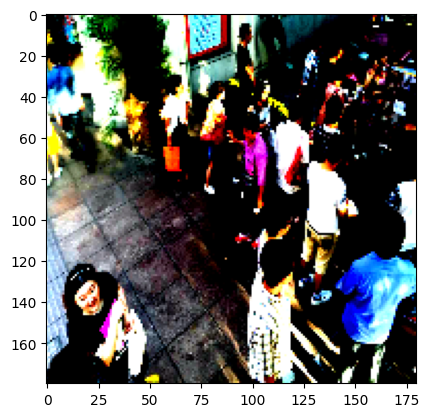

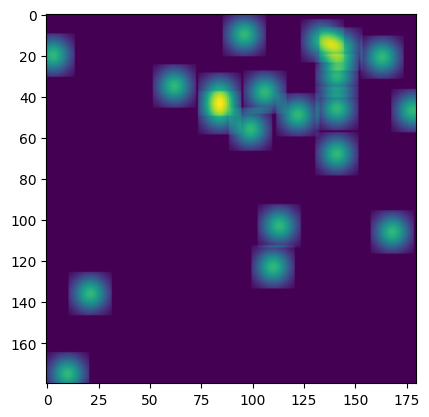

20.0
1/1 [==============================] - 0s 116ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 20.0
people in pred image = 0.57312727


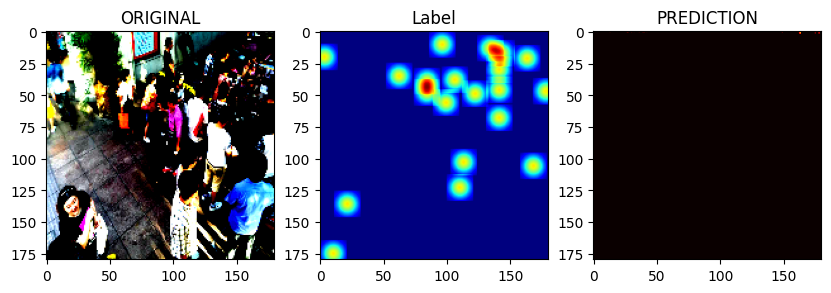

In [97]:
show_model_preds(auto_encoder_3,14,cmap='hot')

### Auto Encoder 2

In [98]:
another_auto_encoder_2 =  another_auto_encoder(INPUT_DIM)

In [99]:
another_auto_encoder_2.compile(loss="mse",optimizer=RMSprop(learning_rate=0.00001),metrics=['mae'])

In [100]:
checkpoint_ae_2_path = './ae_2_with_patches.h5'
model_auto_encoder_with_patches_2_history = another_auto_encoder_2.fit(
    train_ds_with_patches,
    validation_data=val_ds,
    epochs=30,
    callbacks=[create_checkpoint_callback(checkpoint_ae_2_path)]
)

Epoch 1/30
75/75 [==============================] - 3s 31ms/step - loss: 1.0275 - mae: 0.7359 - val_loss: 0.9544 - val_mae: 0.7525
Epoch 2/30
75/75 [==============================] - 2s 30ms/step - loss: 0.5719 - mae: 0.5407 - val_loss: 0.4653 - val_mae: 0.5054
Epoch 3/30
75/75 [==============================] - 2s 30ms/step - loss: 0.2835 - mae: 0.3694 - val_loss: 0.2218 - val_mae: 0.3272
Epoch 4/30
75/75 [==============================] - 2s 30ms/step - loss: 0.1252 - mae: 0.2353 - val_loss: 0.1076 - val_mae: 0.2144
Epoch 5/30
75/75 [==============================] - 2s 29ms/step - loss: 0.0588 - mae: 0.1614 - val_loss: 0.0657 - val_mae: 0.1765
Epoch 6/30
75/75 [==============================] - 2s 29ms/step - loss: 0.0373 - mae: 0.1370 - val_loss: 0.0498 - val_mae: 0.1584
Epoch 7/30
75/75 [==============================] - 2s 28ms/step - loss: 0.0285 - mae: 0.1216 - val_loss: 0.0394 - val_mae: 0.1407
Epoch 8/30
75/75 [==============================] - 2s 29ms/step - loss: 0.0227 - m

In [ ]:
another_auto_encoder_2.load_weights('./ae_2_with_patches.h5')

In [101]:
another_auto_encoder_2.evaluate(test_ds)

20/20 [==============================] - 0s 11ms/step - loss: 0.0039 - mae: 0.0403


[0.003883820492774248, 0.04034405201673508]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


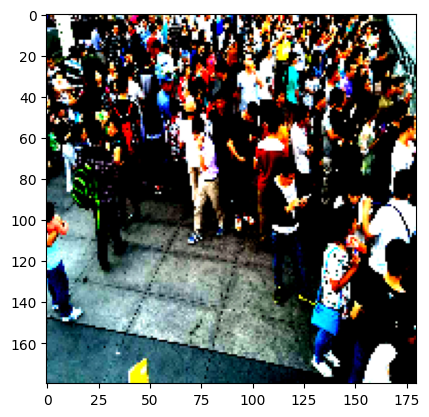

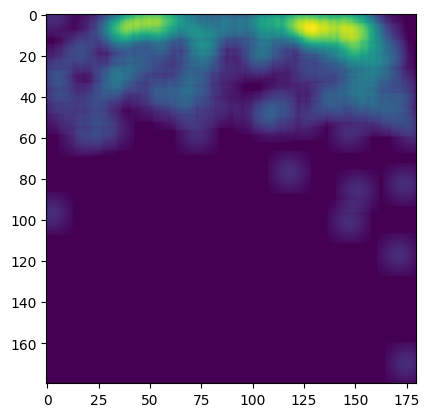

138.99999999999997
1/1 [==============================] - 0s 78ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 138.99999999999997
people in pred image = -7.244833


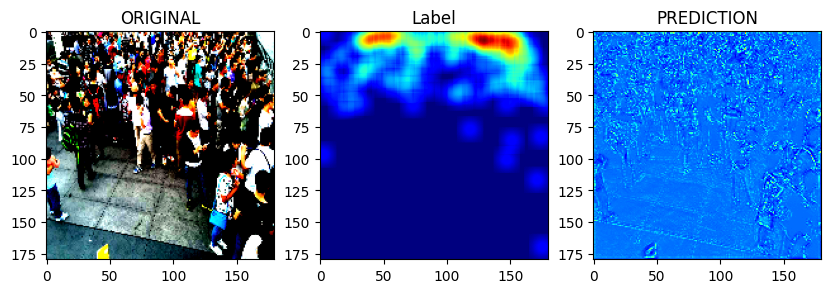

In [102]:
show_model_preds(another_auto_encoder_2,10,)

### MCNN

In [103]:
mcnn_2 = MCNN()
mcnn_2.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=['mae'])

In [104]:
checkpoint_mcnn_2_path = './mcnn_2_with_patches.h5'
model_mcnn_with_patches_2_history = mcnn_2.fit(
    train_ds_with_patches,
    validation_data=val_ds,
    epochs=30,
    callbacks=[create_checkpoint_callback(checkpoint_mcnn_2_path)]
)

Epoch 1/30
75/75 [==============================] - 3s 29ms/step - loss: 0.0021 - mae: 0.0296 - val_loss: 0.0013 - val_mae: 0.0252
Epoch 2/30
75/75 [==============================] - 2s 27ms/step - loss: 0.0011 - mae: 0.0196 - val_loss: 0.0013 - val_mae: 0.0256
Epoch 3/30
75/75 [==============================] - 2s 26ms/step - loss: 9.7274e-04 - mae: 0.0179 - val_loss: 0.0013 - val_mae: 0.0263
Epoch 4/30
75/75 [==============================] - 2s 27ms/step - loss: 9.1200e-04 - mae: 0.0170 - val_loss: 0.0013 - val_mae: 0.0260
Epoch 5/30
75/75 [==============================] - 2s 27ms/step - loss: 8.6500e-04 - mae: 0.0161 - val_loss: 0.0013 - val_mae: 0.0265
Epoch 6/30
75/75 [==============================] - 2s 26ms/step - loss: 8.3886e-04 - mae: 0.0157 - val_loss: 0.0013 - val_mae: 0.0269
Epoch 7/30
75/75 [==============================] - 2s 26ms/step - loss: 8.1588e-04 - mae: 0.0152 - val_loss: 0.0013 - val_mae: 0.0271
Epoch 8/30
75/75 [==============================] - 2s 26ms/ste

In [105]:
mcnn_2.evaluate(test_ds)

20/20 [==============================] - 0s 11ms/step - loss: 3.2575e-04 - mae: 0.0128


[0.0003257515490986407, 0.012832298874855042]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


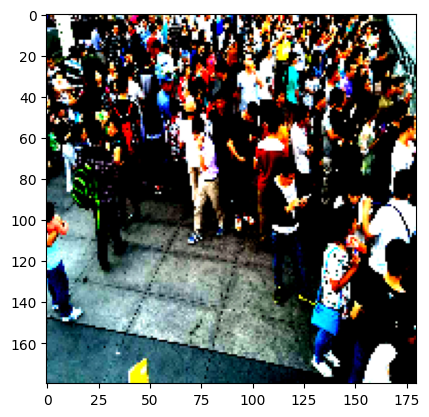

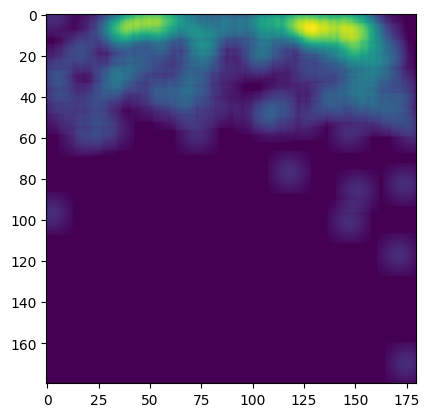

138.99999999999997
1/1 [==============================] - 0s 88ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 138.99999999999997
people in pred image = 497.00128


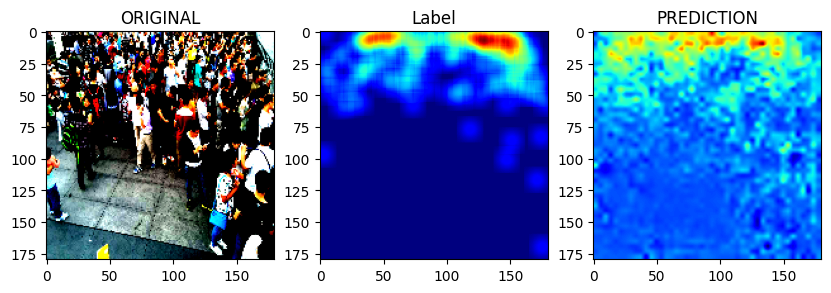

In [106]:
show_model_preds(mcnn_2,10)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_102.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_102.mat


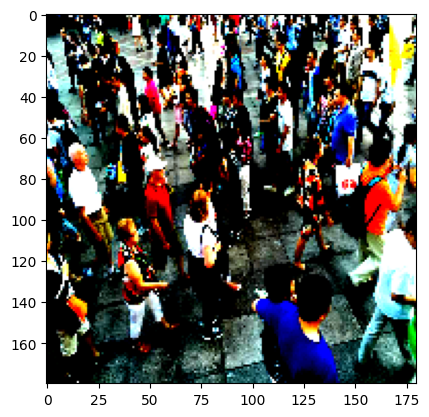

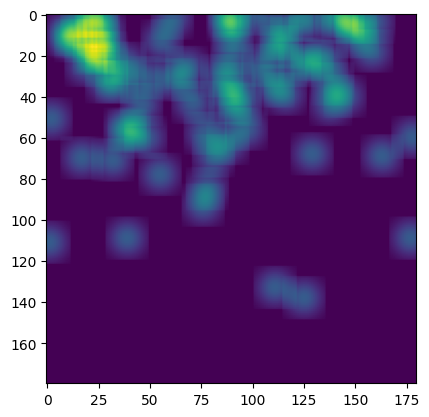

69.99999999999999
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 69.99999999999999
people in pred image = 484.14447


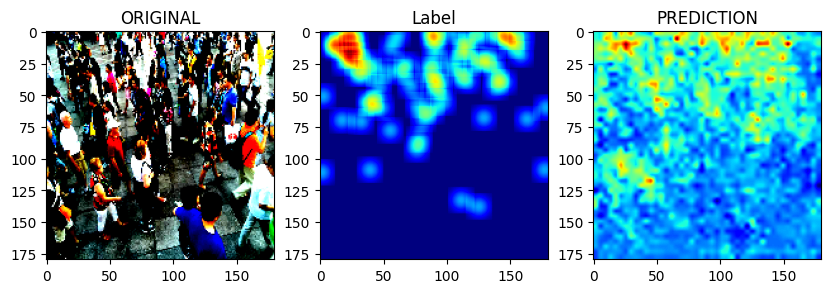

In [108]:
show_model_preds(mcnn_2,4)

## Try out another training ds with patches and larger images but without the normal augmentation

In [47]:
# INPUT_DIM = 256

In [48]:
train_ds_with_patches_2 = prepare_ds_with_patches(
    X_train,
    Y_train,
    shuffle=True,
    augment=False,
    from_scipy=False,
    use_patches=True
)

600
600
(1200, 180, 180, 3)
(1200, 180, 180)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


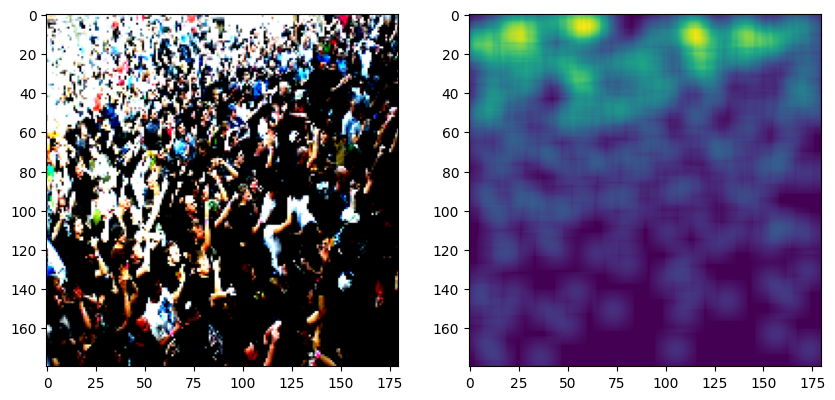

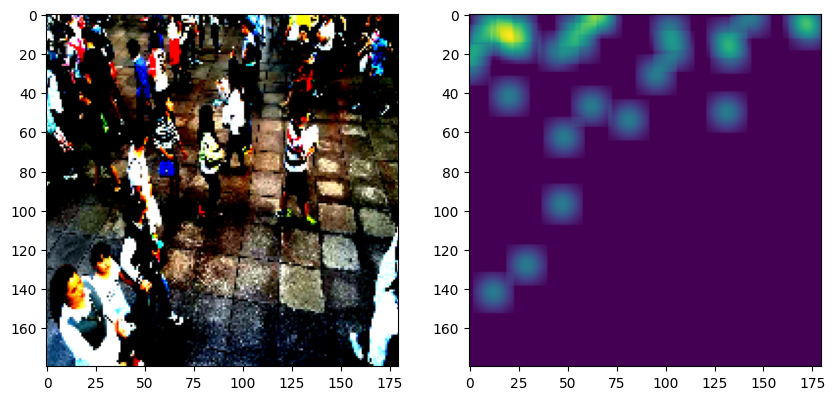

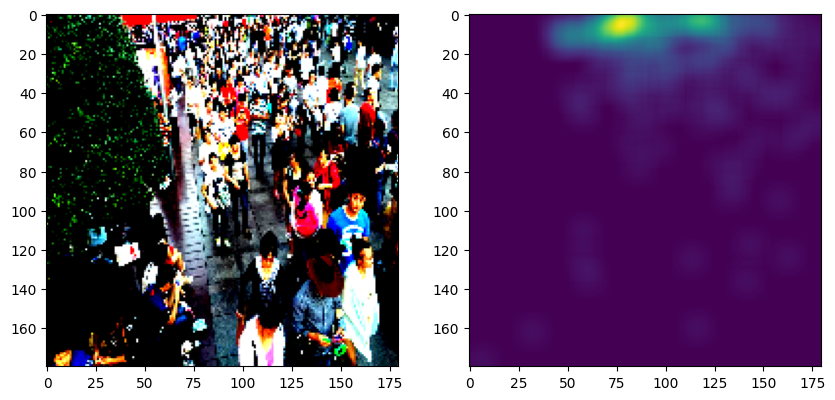

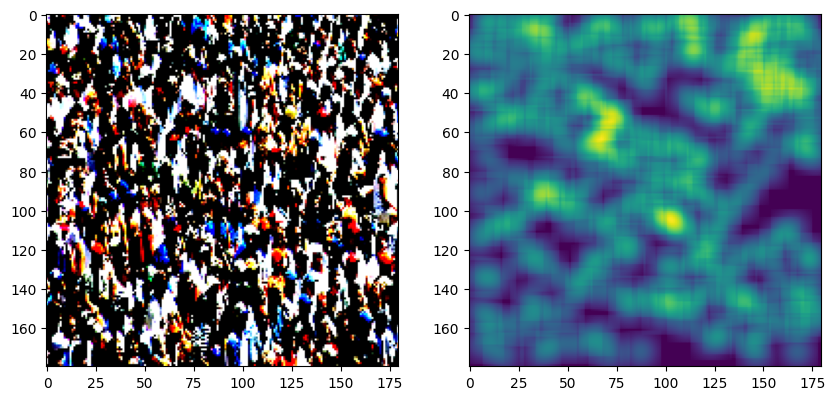

In [49]:
j=0
for f,g in train_ds_with_patches_2.take(2).unbatch():
    fig,axes = plt.subplots(1,2,figsize=(10,10))
    axes[0].imshow(f)
    axes[1].imshow(g)
    j+=1
    if j>3:
        break

### Auto Encoder 1

In [415]:
encoder_ae_4 = encoder_ae(INPUT_DIM)

In [416]:
decoder_ae_4 = decoder_ae(encoder_ae_4.output.shape[1:])

In [417]:
auto_encoder_4 = auto_encoder(INPUT_DIM,encoder_ae_4,decoder_ae_4)

In [418]:
auto_encoder_4.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=['mae'])

In [419]:
checkpoint_ae_4_path = './ae_with_patches_but_no_aug.h5'
model_auto_encoder_with_patches_history = auto_encoder_4.fit(
    train_ds_with_patches_2,
    validation_data=val_ds,
    epochs=10,
    callbacks=[create_checkpoint_callback(checkpoint_ae_4_path)]
)

Epoch 1/10
38/38 [==============================] - 14s 312ms/step - loss: 0.1680 - mae: 0.3032 - val_loss: 0.0210 - val_mae: 0.0915
Epoch 2/10
38/38 [==============================] - 10s 276ms/step - loss: 0.0200 - mae: 0.0725 - val_loss: 0.0051 - val_mae: 0.0355
Epoch 3/10
38/38 [==============================] - 11s 278ms/step - loss: 0.0068 - mae: 0.0348 - val_loss: 0.0034 - val_mae: 0.0267
Epoch 4/10
38/38 [==============================] - 11s 279ms/step - loss: 0.0040 - mae: 0.0248 - val_loss: 0.0028 - val_mae: 0.0234
Epoch 5/10
38/38 [==============================] - 11s 281ms/step - loss: 0.0029 - mae: 0.0204 - val_loss: 0.0025 - val_mae: 0.0215
Epoch 6/10
38/38 [==============================] - 11s 278ms/step - loss: 0.0023 - mae: 0.0181 - val_loss: 0.0023 - val_mae: 0.0202
Epoch 7/10
38/38 [==============================] - 11s 280ms/step - loss: 0.0020 - mae: 0.0166 - val_loss: 0.0021 - val_mae: 0.0193
Epoch 8/10
38/38 [==============================] - 11s 288ms/step - 

In [60]:
auto_encoder_4.load_weights(checkpoint_ae_4_path)

In [420]:
auto_encoder_4.evaluate(test_ds)

10/10 [==============================] - 2s 169ms/step - loss: 9.3813e-04 - mae: 0.0080


[0.0009381267591379583, 0.007984879426658154]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_102.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_102.mat


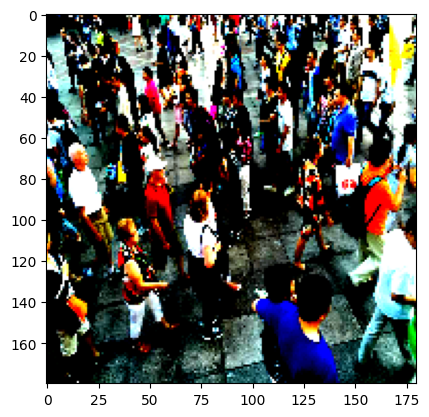

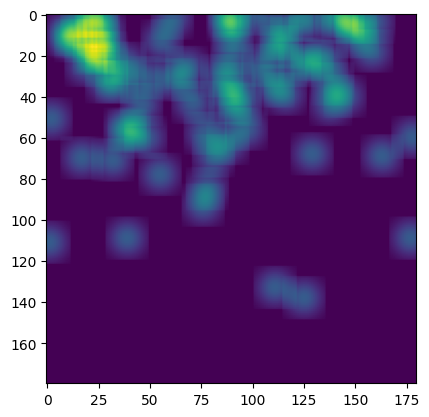

69.99999999999999
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 69.99999999999999
people in pred image = 153.67911


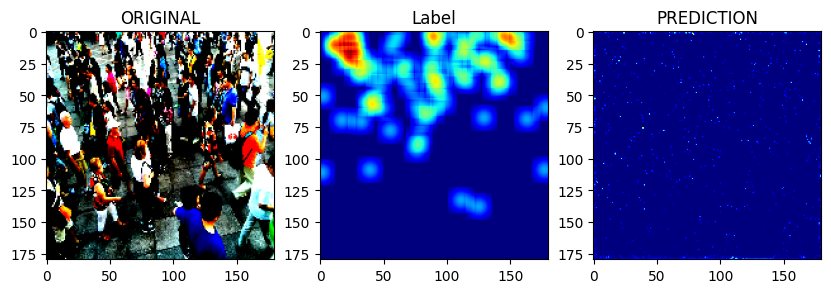

In [425]:
show_model_preds(auto_encoder_4,4)

### Auto Encoder 2

In [429]:
another_auto_encoder_3 =  another_auto_encoder(INPUT_DIM)

In [430]:
another_auto_encoder_3.compile(loss="mse",optimizer=RMSprop(learning_rate=0.00001),metrics=['mae'])

In [431]:
checkpoint_ae_2_3_path = './ae_2_with_patches_no_aug.h5'
model_auto_encoder_with_patches_3_history = another_auto_encoder_3.fit(
    train_ds_with_patches_2,
    validation_data=val_ds,
    epochs=10,
    callbacks=[create_checkpoint_callback(checkpoint_ae_2_3_path)]
)

Epoch 1/10
38/38 [==============================] - 3s 57ms/step - loss: 0.1122 - mae: 0.2490 - val_loss: 0.0753 - val_mae: 0.1965
Epoch 2/10
38/38 [==============================] - 2s 55ms/step - loss: 0.0800 - mae: 0.2093 - val_loss: 0.0614 - val_mae: 0.1794
Epoch 3/10
38/38 [==============================] - 2s 56ms/step - loss: 0.0644 - mae: 0.1899 - val_loss: 0.0577 - val_mae: 0.1799
Epoch 4/10
38/38 [==============================] - 2s 54ms/step - loss: 0.0539 - mae: 0.1758 - val_loss: 0.0546 - val_mae: 0.1778
Epoch 5/10
38/38 [==============================] - 2s 55ms/step - loss: 0.0459 - mae: 0.1626 - val_loss: 0.0512 - val_mae: 0.1720
Epoch 6/10
38/38 [==============================] - 2s 55ms/step - loss: 0.0394 - mae: 0.1498 - val_loss: 0.0477 - val_mae: 0.1648
Epoch 7/10
38/38 [==============================] - 2s 55ms/step - loss: 0.0340 - mae: 0.1381 - val_loss: 0.0440 - val_mae: 0.1570
Epoch 8/10
38/38 [==============================] - 2s 54ms/step - loss: 0.0297 - m

In [77]:
another_auto_encoder_3.load_weights(checkpoint_ae_2_3_path)

In [432]:
another_auto_encoder_3.evaluate(test_ds)

10/10 [==============================] - 0s 20ms/step - loss: 0.0279 - mae: 0.1169


[0.027910558506846428, 0.11692067980766296]

shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


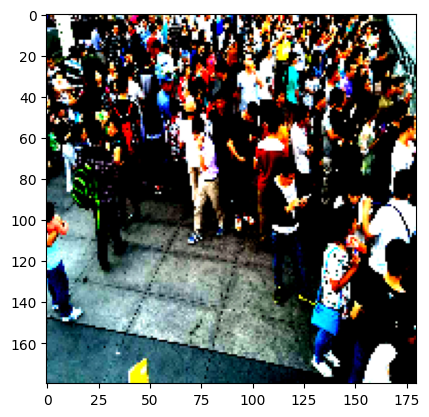

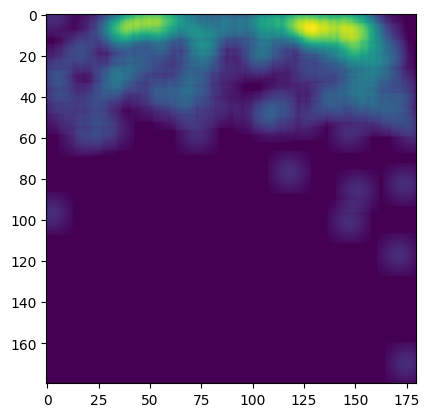

138.99999999999997
1/1 [==============================] - 0s 18ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 138.99999999999997
people in pred image = -1698.4678


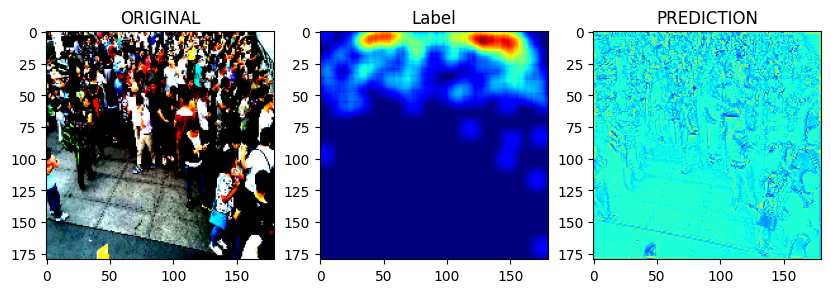

In [435]:
show_model_preds(another_auto_encoder_3,10)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_117.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_117.mat


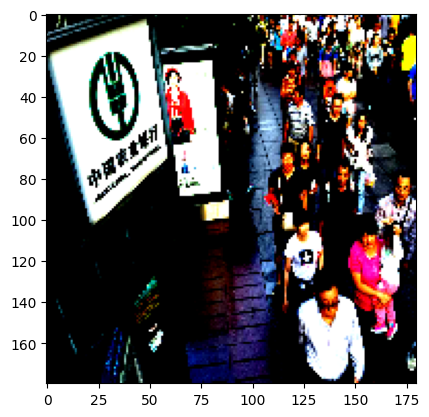

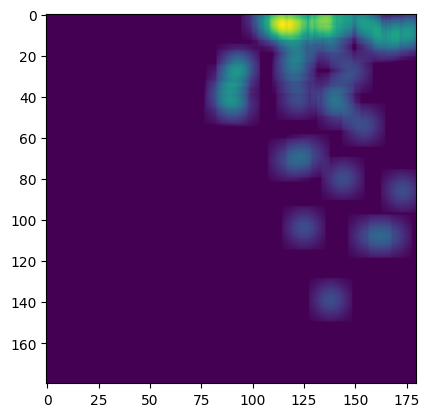

40.0
1/1 [==============================] - 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 40.0
people in pred image = -1423.8826


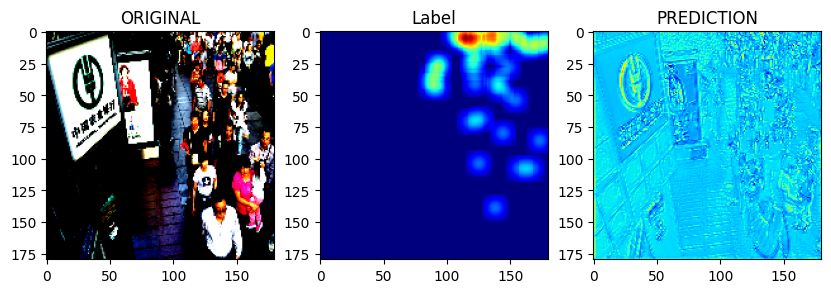

In [436]:
show_model_preds(another_auto_encoder_3,20)

### MCNN

In [443]:
mcnn_3 = MCNN((INPUT_DIM,INPUT_DIM,3))
mcnn_3.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=['mae'])

In [444]:
checkpoint_mcnn_3_path = './mcnn_3_with_patches.h5'
model_mcnn_with_patches_2_history = mcnn_3.fit(
    train_ds_with_patches_2,
    validation_data=val_ds,
    epochs=20,
    callbacks=[create_checkpoint_callback(checkpoint_mcnn_3_path)]
)

Epoch 1/20
38/38 [==============================] - 3s 53ms/step - loss: 0.0091 - mae: 0.0683 - val_loss: 0.0044 - val_mae: 0.0498
Epoch 2/20
38/38 [==============================] - 2s 49ms/step - loss: 0.0031 - mae: 0.0404 - val_loss: 0.0029 - val_mae: 0.0403
Epoch 3/20
38/38 [==============================] - 2s 50ms/step - loss: 0.0024 - mae: 0.0349 - val_loss: 0.0024 - val_mae: 0.0367
Epoch 4/20
38/38 [==============================] - 2s 50ms/step - loss: 0.0020 - mae: 0.0318 - val_loss: 0.0021 - val_mae: 0.0336
Epoch 5/20
38/38 [==============================] - 2s 50ms/step - loss: 0.0018 - mae: 0.0293 - val_loss: 0.0018 - val_mae: 0.0309
Epoch 6/20
38/38 [==============================] - 2s 50ms/step - loss: 0.0016 - mae: 0.0274 - val_loss: 0.0016 - val_mae: 0.0290
Epoch 7/20
38/38 [==============================] - 2s 48ms/step - loss: 0.0015 - mae: 0.0259 - val_loss: 0.0015 - val_mae: 0.0275
Epoch 8/20
38/38 [==============================] - 2s 50ms/step - loss: 0.0014 - m

In [70]:
# mcnn_3.load_weights(checkpoint_mcnn_3_path)

In [445]:
mcnn_3.evaluate(test_ds)

10/10 [==============================] - 0s 19ms/step - loss: 4.9815e-04 - mae: 0.0159


[0.0004981486708857119, 0.01589641347527504]

shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


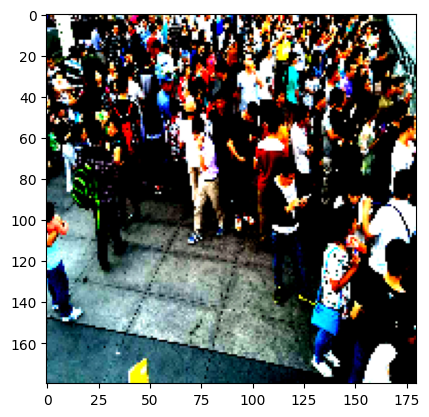

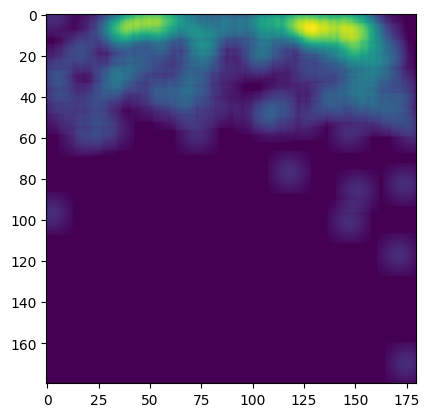

138.99999999999997
1/1 [==============================] - 0s 88ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 138.99999999999997
people in pred image = 378.45486


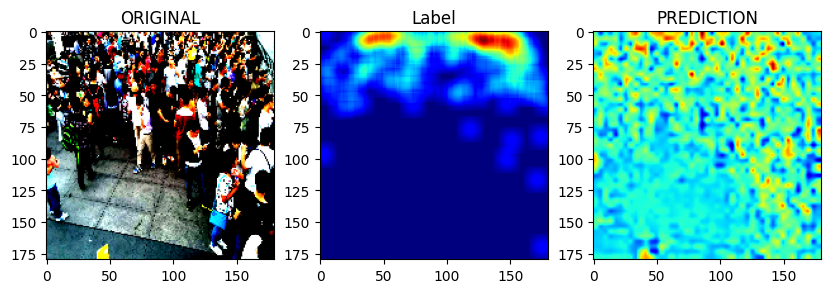

In [446]:
show_model_preds(mcnn_3,10)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_117.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_117.mat


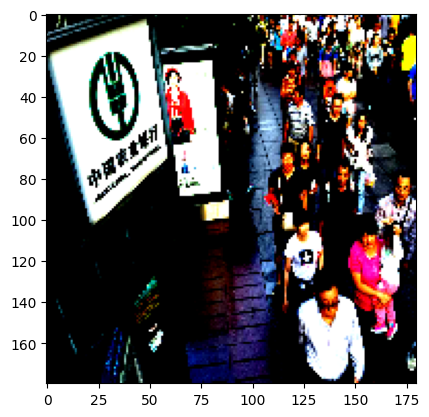

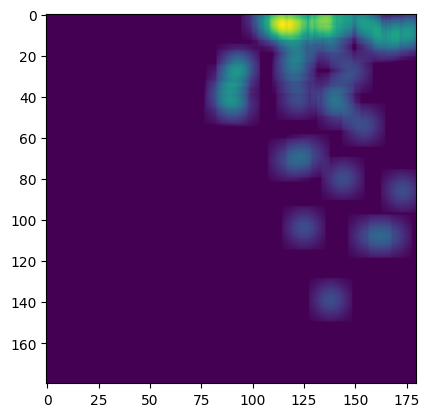

40.0
1/1 [==============================] - 0s 16ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 40.0
people in pred image = 262.80154


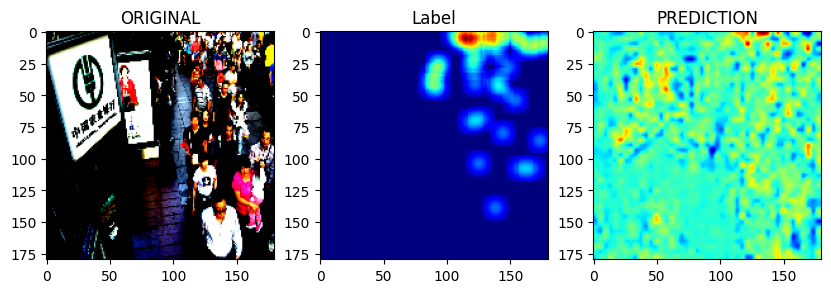

In [447]:
show_model_preds(mcnn_3,20)

In [ ]:
def test_custom_image(custom_image_path,model)
    custom_image = cv2.cvtColor(cv2.imread(custom_image_path),cv2.COLOR_BGR2RGB)
    custom_image = cv2.resize(custom_image,(INPUT_DIM,INPUT_DIM))
    custom_image = custom_image.astype('float32')
    custom_image /= 255.
    plt.imshow(custom_image)
    plt.show()
    preds = model.predict(np.expand_dims(custom_image,axis=0))
    plt.imshow(preds[0],cmap='hot')
    plt.show()
    print(np.sum(preds[0]))

# Auto Encoder based on Inception Model

In [55]:
inception_v3 = tf.keras.applications.inception_v3.InceptionV3(
    include_top=False,
    weights='imagenet',
    input_shape=(INPUT_DIM,INPUT_DIM,3),
)

In [56]:
def get_inception_model(inception_model):
    # print(inception_model.summary())
    activation_28  = inception_model.get_layer('activation_28').output
    inception_v3_base_model = Model(inputs=inception_model.inputs,outputs=activation_28)

    return inception_v3_base_model


In [57]:
inception_v3_base_model = get_inception_model(inception_v3)
inception_v3_base_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 89, 89, 32)   864         ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 89, 89, 32)  96          ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                              

In [109]:
def get_decoder_for_inception(inception_v3_base_model):
    decoder_input = Input(shape=inception_v3_base_model.output.shape[1:])
    #
    y = Conv2DTranspose(32,(2,2),strides=2)(decoder_input)
    y = ReLU()(y)
    y = Dropout(0.3)(y)

    #
    y = Conv2DTranspose(32,(2,2),strides=2)(y)
    y = ReLU()(y)
    y = Dropout(0.3)(y)

    y = Conv2DTranspose(1,(2,2),strides=2)(y)
    y = ReLU()(y)
    
    decoder_output = Resizing(height=INPUT_DIM,width=INPUT_DIM)(y)[...,0]
#########################################
# if you wan to do it without Resizing layer uncomment the following lines
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
#     y = Dropout(0.3)(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
#     y = Dropout(0.3)(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
#     y = Dropout(0.1)(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
#     y = Dropout(0.1)(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
#     y = Dropout(0.1)(y)
    
#     y = Conv2DTranspose(32,(3,3),strides=1)(y)
#     y = ReLU()(y)
    
#     y = Conv2DTranspose(1,(3,3),strides=1)(y)
#     decoder_output = ReLU()(y)
#     decoder_output = decoder_output[...,0]
    
#     decoder_output = Resizing(height=INPUT_DIM,width=INPUT_DIM)(y)
#################################################
    decoder = Model(inputs=decoder_input,outputs=decoder_output)
    return decoder


In [169]:
decoder=get_decoder_for_inception(inception_v3_base_model)
decoder.summary()

Model: "model_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_35 (InputLayer)       [(None, 20, 20, 96)]      0         
                                                                 
 conv2d_transpose_211 (Conv2  (None, 40, 40, 32)       12320     
 DTranspose)                                                     
                                                                 
 re_lu_211 (ReLU)            (None, 40, 40, 32)        0         
                                                                 
 dropout_119 (Dropout)       (None, 40, 40, 32)        0         
                                                                 
 conv2d_transpose_212 (Conv2  (None, 80, 80, 32)       4128      
 DTranspose)                                                     
                                                                 
 re_lu_212 (ReLU)            (None, 80, 80, 32)        0  

In [170]:
def get_auto_encoder_inception(inception_v3_base_model):
    decoder = get_decoder_for_inception(inception_v3_base_model)
    auto_encoder_with_inception_input = Input(shape=(INPUT_DIM,INPUT_DIM,3))
    encoder_inception = inception_v3_base_model(auto_encoder_with_inception_input)
    auto_encoder_with_inception_output = decoder(encoder_inception)
    auto_encoder_with_inception = Model(inputs=auto_encoder_with_inception_input,outputs=auto_encoder_with_inception_output)
    return auto_encoder_with_inception

In [57]:
np.expand_dims(np.zeros(shape=(180,180)),axis=-1).shape

(180, 180, 1)

In [58]:
0/(0+1e-20)

0.0

## New loss function

In [60]:
def gaussian_kernel(sigma=6.0, kernel_size=2):
    x = np.linspace(-kernel_size, kernel_size, 2*kernel_size+1)
    kernel = gauss_distribution(x,sigma=sigma)
    kernel = kernel.T @ kernel
    kernel = kernel / tf.math.reduce_max(kernel)
    kernel = tf.expand_dims(kernel,axis=-1)
    kernel = tf.expand_dims(kernel,axis=-1)
    return kernel

In [61]:
gauss_kernel = gaussian_kernel()
gauss_kernel.shape

TensorShape([5, 5, 1, 1])

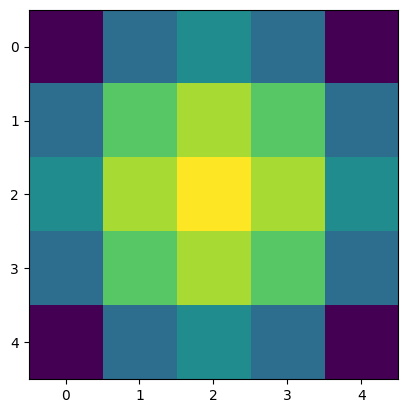

In [62]:
plt.imshow(gauss_kernel[:,:,0,0])
plt.show()

In [63]:
b = tf.constant([1,1,3,3], tf.int32)
b

<tf.Tensor: shape=(4,), dtype=int32, numpy=array([1, 1, 3, 3], dtype=int32)>

In [64]:
gauss_kernel=tf.cast(tf.tile(gauss_kernel,b),dtype=tf.float32)
gauss_kernel.shape

TensorShape([5, 5, 3, 3])

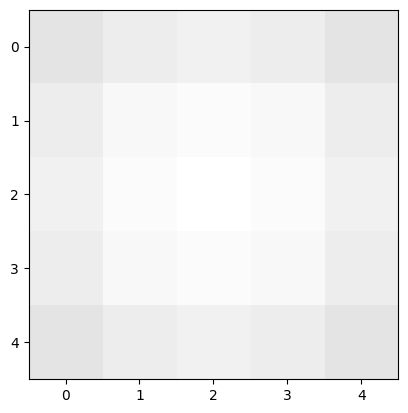

In [65]:
plt.imshow(gauss_kernel[:,:,:,0])
plt.show()

In [66]:
test_image_path = './shanghaitech/ShanghaiTech/part_A/train_data/images/IMG_100.jpg'
test_image_label_path = './shanghaitech/ShanghaiTech/part_A/train_data/ground-truth/GT_IMG_100.mat'
plt.figure(figsize=(20,20))
# preprocess image
test_image = cv2.imread(test_image_path)
test_image = cv2.cvtColor(test_image,cv2.COLOR_BGR2RGB)
# test_image = cv2.resize(test_image,(IN_Y,IN_X))
test_image = test_image.astype('float32')
test_image/=255.
test_image[:,:,0] = (test_image[:,:,0]-np.mean(test_image[:,:,0]))/np.std(test_image[:,:,0])
test_image[:,:,1] = (test_image[:,:,1]-np.mean(test_image[:,:,1]))/np.std(test_image[:,:,1])
test_image[:,:,2] = (test_image[:,:,2]-np.mean(test_image[:,:,2]))/np.std(test_image[:,:,2])

<Figure size 2000x2000 with 0 Axes>

In [67]:
test_image.shape,test_image.dtype

((654, 1024, 3), dtype('float32'))

In [68]:
img_smooth = tf.nn.conv2d(
    tf.expand_dims(tf.cast(test_image,dtype=tf.float32),axis=0), 
    gauss_kernel, 
    strides=[1, 1, 1, 1], 
    padding="SAME"
)

In [69]:
img_smooth.shape

TensorShape([1, 654, 1024, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


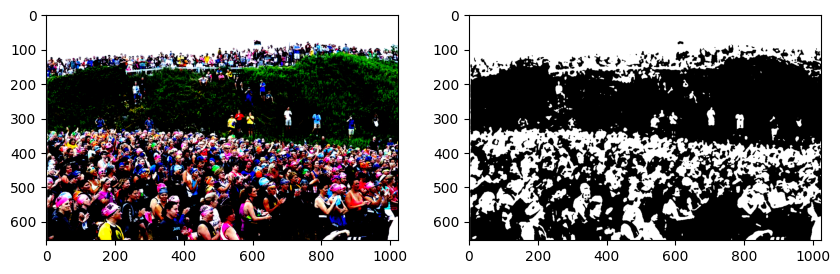

In [70]:
fig, axes = plt.subplots(1,2,figsize=(10,10))
axes[0].imshow(test_image)
axes[1].imshow(img_smooth[0])


In [139]:
def density_map_loss(y_true, y_pred):
    """
    Custom loss function for crowd counting using density maps.

    Args:
    - y_true: The ground truth density map (tensor, shape=[batch_size, height, width, 1]).
    - y_pred: The predicted density map (tensor, shape=[batch_size, height, width, 1]).

    Returns:
    - loss: The custom density map loss.
    """
    # Calculate the Gaussian kernel for smoothing
    gaussian = gaussian_kernel(sigma=6.0, kernel_size=2)
    gaussian=tf.cast(gaussian,dtype=tf.float32)
    # print(gaussian.shape,y_true.shape,y_pred.shape)
    # print(gaussian.shape)
    # Smooth the density maps using convolution
    mue_y = tf.nn.conv2d(tf.expand_dims(y_true,axis=-1), gaussian, strides=[1, 1, 1, 1], padding="SAME")
    mue_f = tf.nn.conv2d(tf.expand_dims(y_pred,axis=-1), gaussian, strides=[1, 1, 1, 1], padding="SAME")
    
    var_y = tf.nn.conv2d(tf.square(tf.expand_dims(y_true,axis=-1)), gaussian, strides=[1, 1, 1, 1], padding="SAME")-tf.square(mue_y)
    var_f = tf.nn.conv2d(tf.square(tf.expand_dims(y_pred,axis=-1)), gaussian, strides=[1, 1, 1, 1], padding="SAME")-tf.square(mue_f)
    
    prod_of_means = mue_f*mue_y
    prod_of_maps = tf.expand_dims(y_true,axis=-1)*tf.expand_dims(y_pred,axis=-1)
    covariance = tf.nn.conv2d(prod_of_maps, gaussian, strides=[1, 1, 1, 1], padding="SAME")-prod_of_means
    
    c1 = 1e-8
    ssim = ((2*mue_f+c1)*(2*covariance+c1))/(((tf.square(mue_f)+tf.square(mue_y)+c1)*(tf.square(var_f)+tf.square(var_y)+c1)))
    consistency_loss = tf.abs(1-tf.reduce_mean(ssim))
    # Compute the mean squared error
    mse_loss = tf.reduce_mean(tf.square(y_true - y_pred))
    # print(mse_loss,consistency_loss)
    loss = mse_loss + 0.001 * consistency_loss

    return loss


## Try out MCNN

In [120]:
mcnn_4 = MCNN((INPUT_DIM,INPUT_DIM,3))
mcnn_4.compile(loss=density_map_loss,optimizer=Adam(learning_rate=1e-5),metrics=['mae'])

In [121]:
checkpoint_mcnn_4_path = './mcnn_4_with_patches.h5'
model_mcnn_4_with_patches_2_history = mcnn_4.fit(
    train_ds_with_patches_2,
    validation_data=val_ds,
    epochs=20,
    callbacks=[
        create_checkpoint_callback(checkpoint_mcnn_4_path),
        create_reduceLrOnPlateau(),
        # create_earlystopping()
    ]
)

Epoch 1/20
38/38 [==============================] - 3s 54ms/step - loss: 0.0827 - mae: 0.1444 - val_loss: 0.0856 - val_mae: 0.2040 - lr: 1.0000e-05
Epoch 2/20
38/38 [==============================] - 2s 50ms/step - loss: 0.0880 - mae: 0.1713 - val_loss: 0.0818 - val_mae: 0.1476 - lr: 1.0000e-05
Epoch 3/20
38/38 [==============================] - 2s 49ms/step - loss: 0.0934 - mae: 0.1272 - val_loss: 0.0839 - val_mae: 0.1253 - lr: 1.0000e-05
Epoch 4/20
38/38 [==============================] - 2s 49ms/step - loss: 0.0964 - mae: 0.1085 - val_loss: 0.0822 - val_mae: 0.1244 - lr: 1.0000e-05
Epoch 5/20
38/38 [==============================] - 2s 49ms/step - loss: 0.0892 - mae: 0.1216 - val_loss: 0.0731 - val_mae: 0.1549 - lr: 1.0000e-05
Epoch 6/20
38/38 [==============================] - 2s 49ms/step - loss: 0.0881 - mae: 0.1285 - val_loss: 0.0832 - val_mae: 0.1268 - lr: 1.0000e-05
Epoch 7/20
38/38 [==============================] - 2s 49ms/step - loss: 0.0958 - mae: 0.1116 - val_loss: 0.0828

In [451]:
mcnn_4.load_weights(checkpoint_mcnn_4_path)

In [122]:
mcnn_4.evaluate(test_ds)

20/20 [==============================] - 0s 12ms/step - loss: 0.0813 - mae: 0.1251


[0.08132004737854004, 0.12506450712680817]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_144.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_144.mat


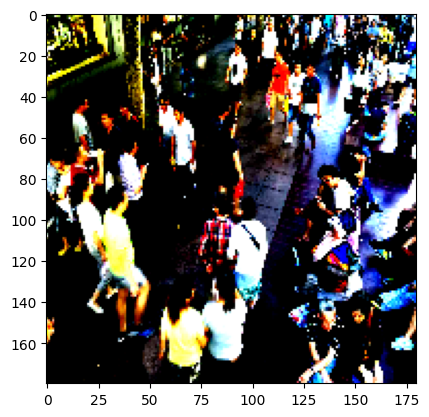

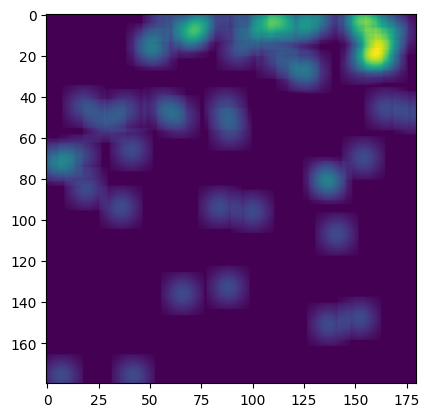

59.00000000000001
1/1 [==============================] - 0s 93ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 59.00000000000001
people in pred image = -1403.6067


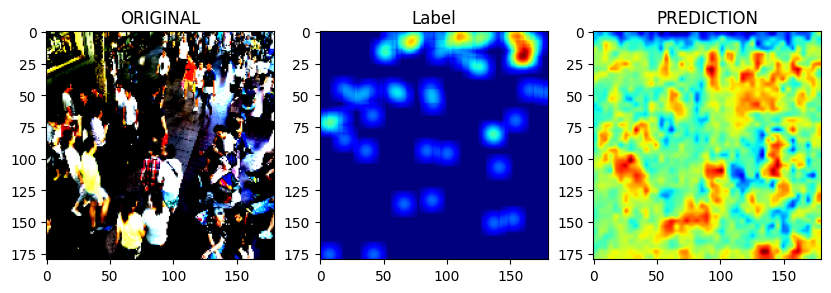

In [123]:
show_model_preds(mcnn_4,50)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_102.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_102.mat


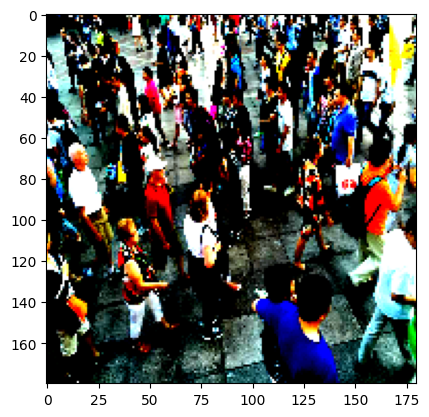

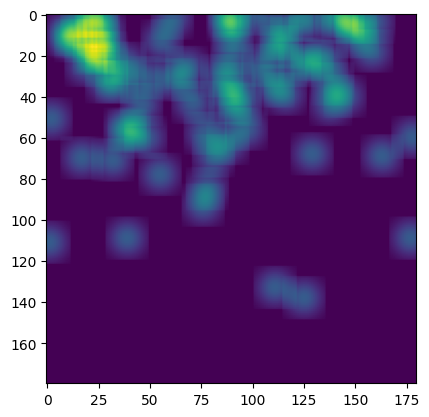

69.99999999999999
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 69.99999999999999
people in pred image = -1363.6913


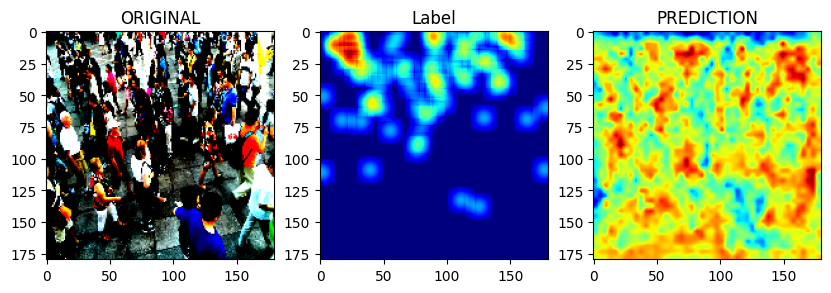

In [124]:
show_model_preds(mcnn_4,4)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_12.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_12.mat


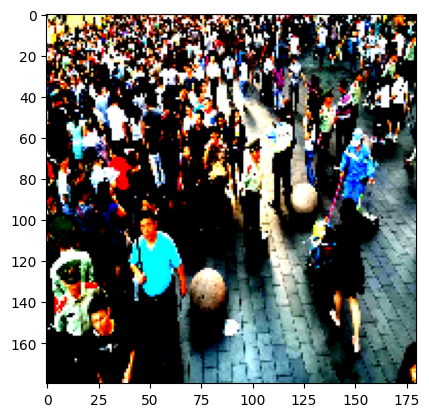

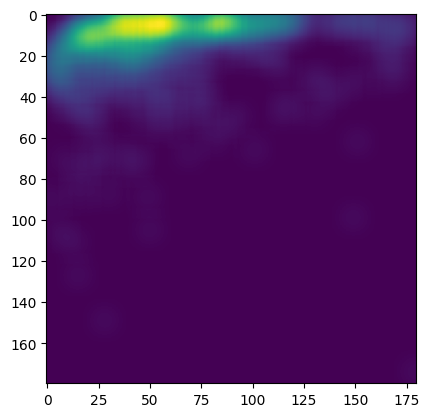

513.0000000000001
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 513.0000000000001
people in pred image = -888.8956


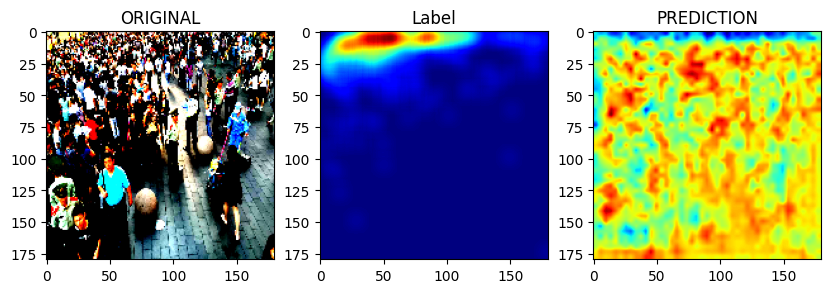

In [125]:
show_model_preds(mcnn_4,23)

## Try out CSRNET model

In [95]:
csrnet_model = get_csrnet_model()
csrnet_model.summary()

Model: "model_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 512, 512, 3)]     0         
                                                                 
 model_9 (Functional)        (None, 64, 64, 512)       7635264   
                                                                 
 conv2d_28 (Conv2D)          (None, 64, 64, 512)       2359808   
                                                                 
 conv2d_29 (Conv2D)          (None, 64, 64, 512)       2359808   
                                                                 
 batch_normalization_12 (Bat  (None, 64, 64, 512)      2048      
 chNormalization)                                                
                                                                 
 conv2d_30 (Conv2D)          (None, 64, 64, 512)       2359808   
                                                          

In [96]:
csrnet_model.compile(loss=density_map_loss,optimizer=Adam(learning_rate = 1e-6),metrics='mae')

In [97]:
csrnet_checkpoint_path = './csrnet_with_aug.h5'
csrnet_history = csrnet_model.fit(
    train_ds_csrnet_no_aug,
    validation_data=val_ds_csrnet,
    epochs=15,
    callbacks=[create_checkpoint_callback(csrnet_checkpoint_path),create_reduceLrOnPlateau()]
)

Epoch 1/15
38/38 [==============================] - 27s 695ms/step - loss: 0.7018 - mae: 0.1527 - val_loss: 62.3123 - val_mae: 7.0755 - lr: 1.0000e-06
Epoch 2/15
38/38 [==============================] - 26s 698ms/step - loss: 0.6681 - mae: 0.1535 - val_loss: 5.3732 - val_mae: 1.8633 - lr: 1.0000e-06
Epoch 3/15
38/38 [==============================] - 27s 703ms/step - loss: 0.6346 - mae: 0.1536 - val_loss: 1.3397 - val_mae: 0.8050 - lr: 1.0000e-06
Epoch 4/15
38/38 [==============================] - 27s 705ms/step - loss: 0.6416 - mae: 0.1535 - val_loss: 0.6440 - val_mae: 0.4481 - lr: 1.0000e-06
Epoch 5/15
38/38 [==============================] - 27s 706ms/step - loss: 0.6403 - mae: 0.1538 - val_loss: 0.3843 - val_mae: 0.3270 - lr: 1.0000e-06
Epoch 6/15
38/38 [==============================] - 27s 706ms/step - loss: 0.6085 - mae: 0.1537 - val_loss: 0.3320 - val_mae: 0.2613 - lr: 1.0000e-06
Epoch 7/15
38/38 [==============================] - 27s 705ms/step - loss: 0.6060 - mae: 0.1527 - v

In [98]:
csrnet_model.evaluate(test_ds_csrnet)

20/20 [==============================] - 4s 187ms/step - loss: 1.1963 - mae: 0.1685


[1.1962579488754272, 0.16846218705177307]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


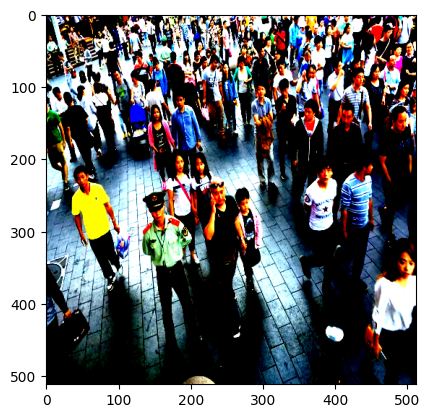

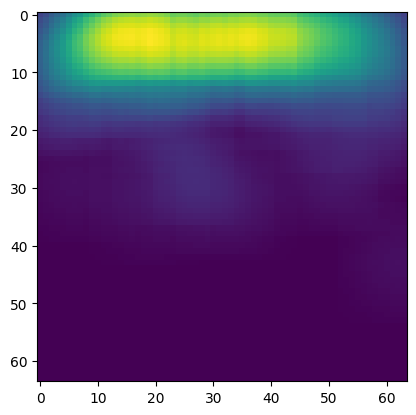

1/1 [==============================] - 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(64, 64)
people in original image = 131.0
people in pred image = 915.46326


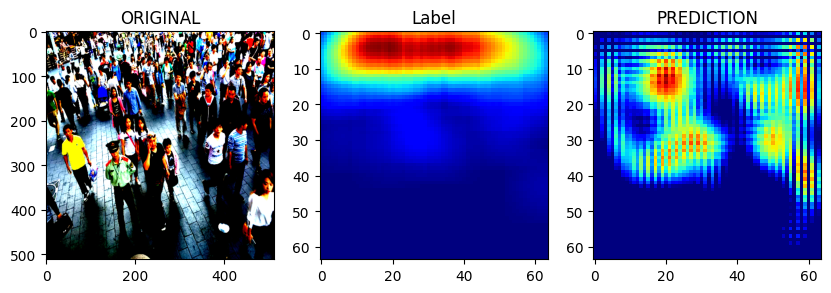

In [100]:
show_csrnet_preds(csrnet_model,15)

In [199]:
csrnet_model_2 = get_csrnet_model()
csrnet_model_2.compile(loss=density_map_loss,optimizer=Adam(learning_rate = 1e-6),metrics='mae')

In [201]:
csrnet_checkpoint_path = './csrnet_with_aug.h5'
csrnet_history = csrnet_model_2.fit(
    train_ds_csrnet_with_aug,
    validation_data=val_ds_csrnet,
    epochs=15,
    callbacks=[create_checkpoint_callback(csrnet_checkpoint_path),create_reduceLrOnPlateau()]
)

Epoch 1/15
38/38 [==============================] - 46s 966ms/step - loss: 1.3466 - mae: 0.4456 - val_loss: 1147.3511 - val_mae: 30.5602 - lr: 1.0000e-06
Epoch 2/15
38/38 [==============================] - 27s 703ms/step - loss: 1.3321 - mae: 0.4459 - val_loss: 89.9821 - val_mae: 7.6119 - lr: 1.0000e-06
Epoch 3/15
38/38 [==============================] - 27s 707ms/step - loss: 1.3302 - mae: 0.4463 - val_loss: 17.9134 - val_mae: 2.8834 - lr: 1.0000e-06
Epoch 4/15
38/38 [==============================] - 27s 709ms/step - loss: 1.3607 - mae: 0.4464 - val_loss: 5.4065 - val_mae: 1.3281 - lr: 1.0000e-06
Epoch 5/15
38/38 [==============================] - 27s 710ms/step - loss: 1.4014 - mae: 0.4461 - val_loss: 2.4964 - val_mae: 0.7895 - lr: 1.0000e-06
Epoch 6/15
38/38 [==============================] - 27s 709ms/step - loss: 1.3885 - mae: 0.4453 - val_loss: 1.1981 - val_mae: 0.4702 - lr: 1.0000e-06
Epoch 7/15
38/38 [==============================] - 27s 709ms/step - loss: 1.3701 - mae: 0.446

In [206]:
csrnet_model_2.evaluate(test_ds_csrnet)

20/20 [==============================] - 7s 340ms/step - loss: 2.0736 - mae: 0.5995


[2.0736069679260254, 0.5995425581932068]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


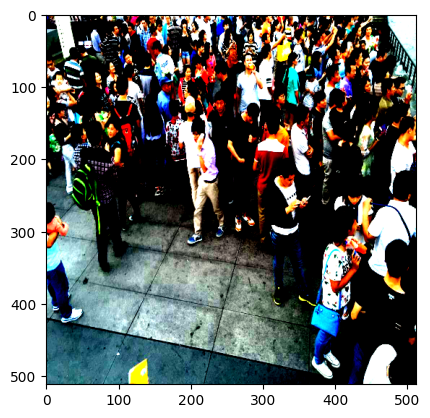

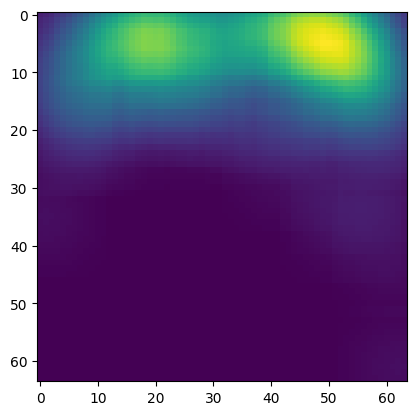

1/1 [==============================] - 0s 17ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(64, 64)
people in original image = 139.0
people in pred image = 2158.1575


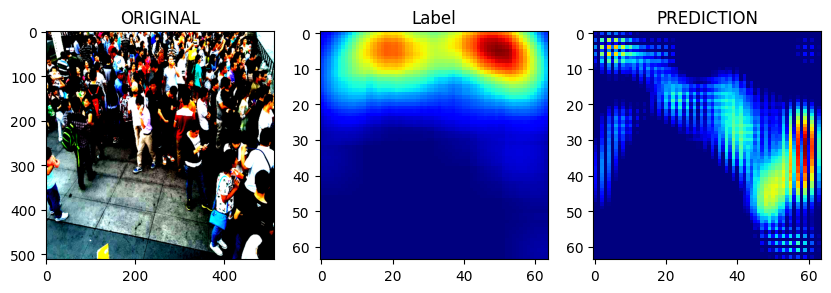

In [213]:
show_csrnet_preds(csrnet_model_2,10)

# Try out data augmentation with 16 patches
This helps in avoiding to resize density maps which messes up the number of people in an image very badly

In [54]:
train_ds_with_16_patches = prepare_ds_with_patches(
    X_train,
    Y_train,
    shuffle=True,
    augment=True,
    from_scipy=False,
    use_patches=True,
    is_nine=False
)

600
600
(1200, 180, 180, 3)
(1200, 180, 180)


In [171]:
auto_encoder_with_inception = get_auto_encoder_inception(inception_v3_base_model)
auto_encoder_with_inception.compile(
    loss=density_map_loss,
    metrics='mae',
    optimizer=Adam(learning_rate=1e-5),
    # run_eagerly=True
)

In [172]:
auto_encoder_with_inception_checkpoint_path = './auto_encoder_with_inception_checkpoint.h5'
auto_encoder_with_inception.fit(
    train_ds_with_16_patches,
    validation_data=val_ds,
    epochs=15,
    callbacks=[
        create_reduceLrOnPlateau(),
        create_checkpoint_callback(auto_encoder_with_inception_checkpoint_path)
    ]
)

Epoch 1/15
75/75 [==============================] - 8s 83ms/step - loss: 110.9715 - mae: 6.5738 - val_loss: 0.0202 - val_mae: 0.0213 - lr: 1.0000e-05
Epoch 2/15
75/75 [==============================] - 6s 78ms/step - loss: 149.6978 - mae: 7.9880 - val_loss: 0.0129 - val_mae: 0.0236 - lr: 1.0000e-05
Epoch 3/15
75/75 [==============================] - 6s 77ms/step - loss: 121.1390 - mae: 6.7518 - val_loss: 0.0099 - val_mae: 0.0255 - lr: 1.0000e-05
Epoch 4/15
75/75 [==============================] - 6s 79ms/step - loss: 143.2645 - mae: 7.7349 - val_loss: 0.0074 - val_mae: 0.0283 - lr: 1.0000e-05
Epoch 5/15
75/75 [==============================] - 6s 80ms/step - loss: 129.1548 - mae: 7.5156 - val_loss: 0.0058 - val_mae: 0.0320 - lr: 1.0000e-05
Epoch 6/15
75/75 [==============================] - 6s 79ms/step - loss: 115.3608 - mae: 6.7543 - val_loss: 0.0053 - val_mae: 0.0351 - lr: 1.0000e-05
Epoch 7/15
75/75 [==============================] - 6s 85ms/step - loss: 116.0751 - mae: 7.1924 - va

In [173]:
auto_encoder_with_inception.evaluate(test_ds)

20/20 [==============================] - 0s 11ms/step - loss: 0.0069 - mae: 0.0619


[0.006914997473359108, 0.06189824268221855]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_1.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_1.mat


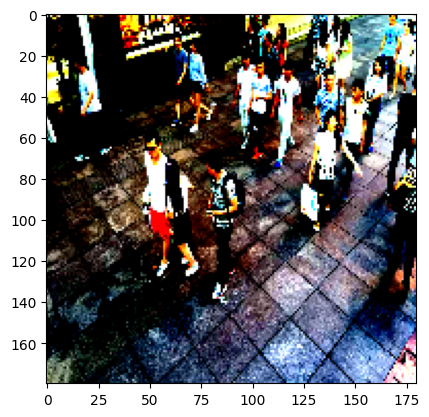

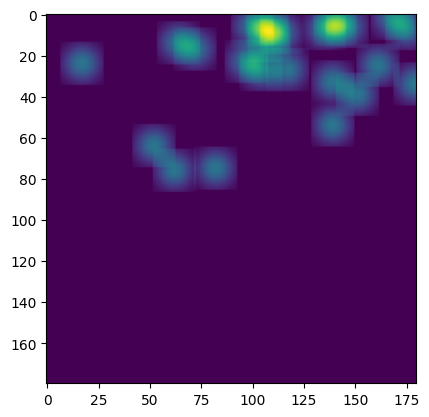

23.0
1/1 [==============================] - 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180)
people in original image = 23.0
people in pred image = 2120.6504


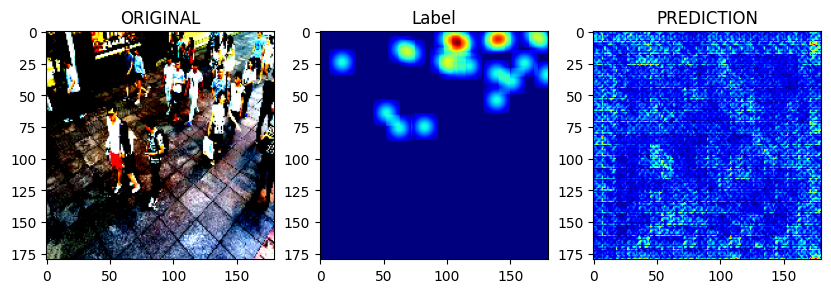

In [176]:
show_model_preds(auto_encoder_with_inception,0)

## Try it on normal ds

In [140]:
auto_encoder_with_inception_2 = get_auto_encoder_inception(inception_v3_base_model)
auto_encoder_with_inception_2.compile(
    loss=density_map_loss,
    metrics='mae',
    optimizer=Adam(learning_rate=1e-5),
    # run_eagerly=True
)

In [141]:
auto_encoder_with_inception_2_checkpoint_path = './auto_encoder_with_inception_2_checkpoint.h5'
auto_encoder_with_inception_2.fit(
    train_ds_no_aug,
    validation_data=val_ds,
    epochs=15,
    callbacks=[
        create_reduceLrOnPlateau(),
        create_checkpoint_callback(auto_encoder_with_inception_2_checkpoint_path)
    ]
)

Epoch 1/15
38/38 [==============================] - 6s 100ms/step - loss: 1.2469 - mae: 0.0118 - val_loss: 1.2737 - val_mae: 0.0125 - lr: 1.0000e-05
Epoch 2/15
38/38 [==============================] - 3s 87ms/step - loss: 0.8027 - mae: 0.0140 - val_loss: 0.9569 - val_mae: 0.0127 - lr: 1.0000e-05
Epoch 3/15
38/38 [==============================] - 3s 87ms/step - loss: 0.6628 - mae: 0.0167 - val_loss: 0.8646 - val_mae: 0.0137 - lr: 1.0000e-05
Epoch 4/15
38/38 [==============================] - 3s 86ms/step - loss: 0.5426 - mae: 0.0198 - val_loss: 0.7509 - val_mae: 0.0154 - lr: 1.0000e-05
Epoch 5/15
38/38 [==============================] - 3s 87ms/step - loss: 0.3875 - mae: 0.0228 - val_loss: 0.5828 - val_mae: 0.0173 - lr: 1.0000e-05
Epoch 6/15
38/38 [==============================] - 3s 87ms/step - loss: 0.2675 - mae: 0.0256 - val_loss: 0.3657 - val_mae: 0.0195 - lr: 1.0000e-05
Epoch 7/15
38/38 [==============================] - 3s 88ms/step - loss: 0.1888 - mae: 0.0282 - val_loss: 0.240

In [144]:
auto_encoder_with_inception_2.evaluate(test_ds)

20/20 [==============================] - 1s 25ms/step - loss: 0.0457 - mae: 0.0393


[0.04569335654377937, 0.03926175832748413]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_126.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_126.mat


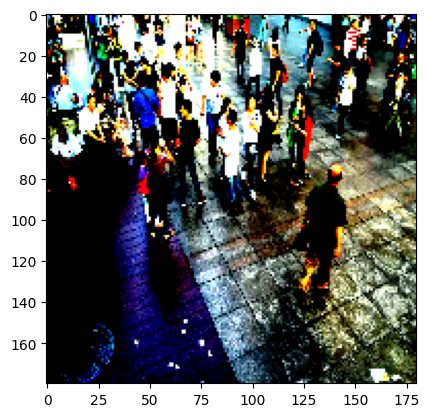

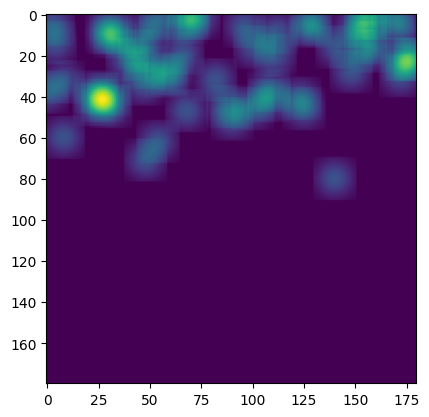

56.0
1/1 [==============================] - 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180)
people in original image = 56.0
people in pred image = 1355.1411


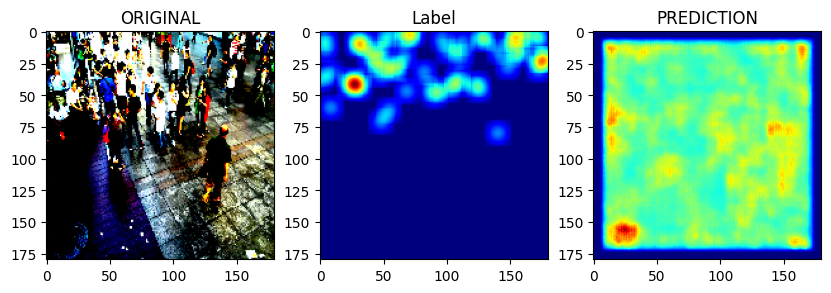

In [147]:
show_model_preds(auto_encoder_with_inception_2,30)

## MCNN

In [178]:
mcnn_5 = MCNN((INPUT_DIM,INPUT_DIM,3))
mcnn_5.compile(loss=density_map_loss,optimizer=Adam(learning_rate=1e-5),metrics=['mae'])

In [159]:
checkpoint_mcnn_5_path = './mcnn_5_with_patches.h5'
model_mcnn_5_with_patches_2_history = mcnn_5.fit(
    train_ds_with_16_patches,
    validation_data=val_ds,
    epochs=20,
    callbacks=[
        create_checkpoint_callback(checkpoint_mcnn_5_path),
        create_reduceLrOnPlateau(),
        # create_earlystopping()
    ]
)

Epoch 1/20
75/75 [==============================] - 8s 86ms/step - loss: 106.8448 - mae: 6.4521 - val_loss: 0.3652 - val_mae: 0.5711 - lr: 1.0000e-05
Epoch 2/20
75/75 [==============================] - 6s 81ms/step - loss: 115.7954 - mae: 7.9380 - val_loss: 1.0852 - val_mae: 0.9906 - lr: 1.0000e-05
Epoch 3/20
75/75 [==============================] - 6s 79ms/step - loss: 90.0287 - mae: 6.8762 - val_loss: 1.9079 - val_mae: 1.3117 - lr: 1.0000e-05
Epoch 4/20
75/75 [==============================] - 6s 84ms/step - loss: 83.9686 - mae: 6.4116 - val_loss: 2.6718 - val_mae: 1.5508 - lr: 1.0000e-05
Epoch 5/20
75/75 [==============================] - 6s 80ms/step - loss: 106.3317 - mae: 6.9975 - val_loss: 2.8750 - val_mae: 1.6082 - lr: 1.0000e-06
Epoch 6/20
75/75 [==============================] - 6s 79ms/step - loss: 77.5667 - mae: 6.0843 - val_loss: 3.0372 - val_mae: 1.6527 - lr: 1.0000e-06
Epoch 7/20
75/75 [==============================] - 6s 83ms/step - loss: 107.4320 - mae: 7.2771 - val_l

In [160]:
mcnn_5.load_weights(checkpoint_mcnn_5_path)

In [161]:
mcnn_5.evaluate(test_ds)

20/20 [==============================] - 0s 21ms/step - loss: 0.3373 - mae: 0.5356


[0.33727219700813293, 0.5355767607688904]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


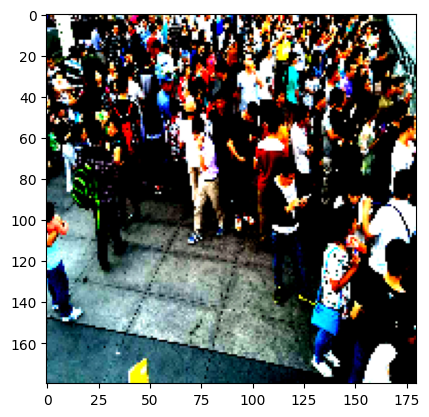

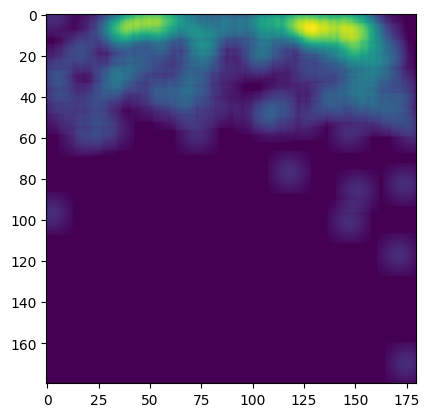

138.99999999999997
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 138.99999999999997
people in pred image = -5965.478


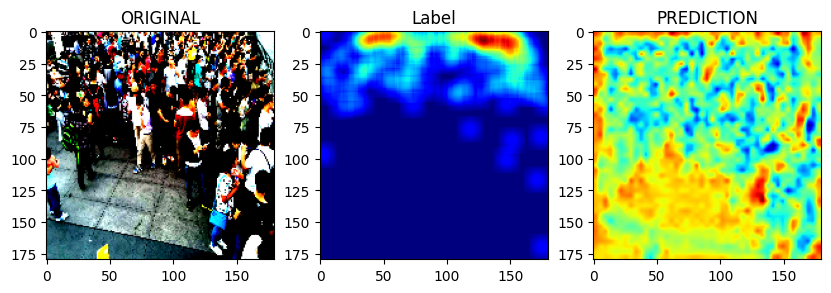

In [181]:
show_model_preds(mcnn_5,10)

## Auto Encoder 2

In [182]:
another_auto_encoder_4 =  another_auto_encoder(INPUT_DIM)

In [183]:
another_auto_encoder_4.compile(loss=density_map_loss,optimizer=RMSprop(learning_rate=0.00001),metrics=['mae'])

In [186]:
checkpoint_ae_2_4_path = './ae_3_with_patches_no_aug.h5'
model_auto_encoder_with_patches_4_history = another_auto_encoder_4.fit(
    train_ds_with_16_patches,
    validation_data=val_ds,
    epochs=10,
    callbacks=[create_checkpoint_callback(checkpoint_ae_2_4_path)]
)

Epoch 1/10
75/75 [==============================] - 6s 84ms/step - loss: 112.4695 - mae: 6.9970 - val_loss: 1.8920 - val_mae: 1.2597
Epoch 2/10
75/75 [==============================] - 6s 83ms/step - loss: 123.9298 - mae: 8.0998 - val_loss: 2.3851 - val_mae: 1.4231
Epoch 3/10
75/75 [==============================] - 6s 84ms/step - loss: 80.0772 - mae: 5.9529 - val_loss: 2.7918 - val_mae: 1.5522
Epoch 4/10
75/75 [==============================] - 6s 84ms/step - loss: 81.8839 - mae: 5.9330 - val_loss: 3.1410 - val_mae: 1.6565
Epoch 5/10
75/75 [==============================] - 6s 83ms/step - loss: 88.0183 - mae: 6.2494 - val_loss: 3.5138 - val_mae: 1.7664
Epoch 6/10
75/75 [==============================] - 6s 84ms/step - loss: 87.7371 - mae: 6.8338 - val_loss: 4.0516 - val_mae: 1.9124
Epoch 7/10
75/75 [==============================] - 6s 82ms/step - loss: 75.2550 - mae: 5.7455 - val_loss: 4.6288 - val_mae: 2.0617
Epoch 8/10
75/75 [==============================] - 6s 84ms/step - loss: 7

In [187]:
another_auto_encoder_4.load_weights(checkpoint_ae_2_4_path)

In [188]:
another_auto_encoder_4.evaluate(test_ds)

20/20 [==============================] - 0s 17ms/step - loss: 1.9838 - mae: 1.3101


[1.9838424921035767, 1.3100652694702148]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shanghaitech/ShanghaiTech/part_B/test_data/images/IMG_108.jpg shanghaitech/ShanghaiTech/part_B/test_data/ground-truth/GT_IMG_108.mat


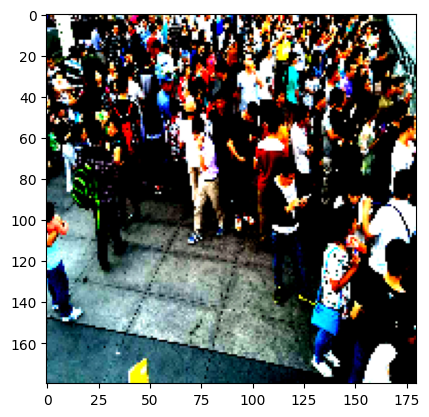

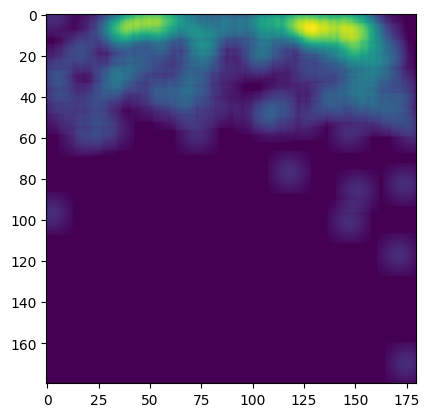

138.99999999999997
1/1 [==============================] - 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(180, 180, 1)
people in original image = 138.99999999999997
people in pred image = 42344.555


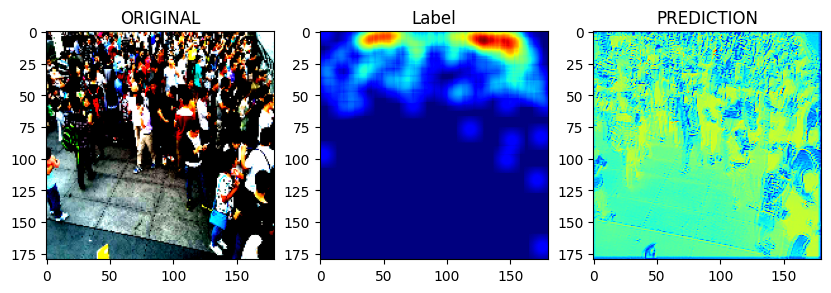

In [189]:
show_model_preds(another_auto_encoder_4,10)